This notebook analyzes the O$_2$ budget from MITgcm+BLING output. Dissolved oxygen in the ocean's interior is simulated following:

$$
\frac{\partial{O_2}}{\partial{t}}= \underbrace{- \frac{\partial{U.O_2}}{\partial{x}} -\frac{\partial{V.O_2}}{\partial{y}}}_\text{Lateral Advection}
- \overbrace{\frac{\partial{W.O_2}}{\partial{z}}}^\text{Vertical Advection}
+ \underbrace{A_h.\nabla^2{O_2}}_\text{Lateral Mixing}
+\overbrace{\frac{\partial{}}{\partial{z}}k.\frac{\partial{O_2}}{\partial{z}}}^\text{Vertical Mixing}
+ \underbrace{ J(O_2)  }_\text{Sources - Sinks}
$$

In [6]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import warnings
warnings.simplefilter("ignore") # Silence warnings

import xarray as xr
import numpy as np
from tqdm import tqdm

import matplotlib.colors as colors
import matplotlib.ticker as mticker
import matplotlib.patches as patches
import cmocean
import cartopy
import cartopy.crs as ccrs
from cartopy import util
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cft
import proplot
# from xmovie import *
import matplotlib.pyplot as plt
from utils import *

from xgcm import Grid

plt.rcParams["figure.facecolor"] = 'white'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload



---
## Spin up Dask Cluster/Client

In [85]:
C=CLSTR(1,59,209,36)
C

Connection method: Cluster object,Cluster type: dask_jobqueue.PBSCluster
Dashboard: https://jupyterhub.hpc.ucar.edu/stable/user/yeddebba/proxy/37973/status,
Dashboard: https://jupyterhub.hpc.ucar.edu/stable/user/yeddebba/proxy/37973/status,Workers: 0
Total threads: 0,Total memory: 0 B
Comm: tcp://10.12.206.46:44660,Workers: 0
Dashboard: https://jupyterhub.hpc.ucar.edu/stable/user/yeddebba/proxy/37973/status,Total threads: 0
Started: Just now,Total memory: 0 B


In [31]:
def plot_depth_section(ax,x,z, var,cntf,lev,clr,units,title,coords,fs,fsx,lw,alp,cb_on,profile):
    if cntf==True: 
        cs= ax.contourf(x,z,var,levels=lev,cmap=clr,extend='both')
        if cb_on==True:
            cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
#             cb.ax.set_title(units,fontsize=fs-1,pad=0.2)
            cb.set_label(units, rotation=0,size=fs-1,position=(1,1.06))
            cb.ax.tick_params(labelsize=fs-1)
            cb.ax.minorticks_off()
    if cntf==False: cs= ax.contour(x,z,var,colors=clr,linewidths=lw,levels=lev,alpha=alp)
    ax.set_title(title,loc='center',fontsize=fs)
    ax.set_ylim(coords[0]); ax.set_xlim(coords[1]); ax.minorticks_on(); 
    ax.set_ylabel('Depth (m)',fontsize=fs-2); 
    ax.set_aspect('auto')
    if profile=='lon': ax.set_xlabel('Latitude ($^{o}$N)',fontsize=fs-2)
    if profile=='lat': ax.set_xlabel('Longitude ($^{o}$E)',fontsize=fs-2)
    ax.set_title(title,pad=0.01,fontsize=fs, loc='center');
    ax.tick_params(axis='both', labelsize=fs)  
    return ax 

def plot_cmap(ax,lon,lat, var,vmn, vmx, stp, clr,units,title,coor,fs,fsx,lon_lab,lat_lab):
    ax.set_extent(coor,crs=cartopy.crs.PlateCarree())
    pc= ax.contourf(lon,lat,var,np.arange(vmn,vmx,stp),cmap=clr,transform=ccrs.PlateCarree(), extend='both') #, 
    land = ax.add_feature(cartopy.feature.NaturalEarthFeature('physical', 'land', '10m',linewidth=0.1, edgecolor='black', facecolor='grey'))
    cb = plt.colorbar(pc, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
    cb.set_label(units, rotation=0,size=fs-1,position=(1.0,1.06))
    cb.ax.minorticks_off()
    cb.ax.tick_params(labelsize=fs)
    ax.set_aspect('auto')
    ax.set_title(title,loc='center',fontsize=fs)
    gl=ax.gridlines(draw_labels=True)
    gl.xlabel_style = {'size': fsx, 'color': 'black'}; gl.ylabel_style = {'size': fsx, 'color': 'black'}; 
    gl.xlabels_top = False; gl.ylabels_right= False; gl.xlines = False; gl.ylines = False
    gl.xlocator = mticker.FixedLocator(lon_lab); gl.ylocator = mticker.FixedLocator(lat_lab)
    gl.xformatter = LONGITUDE_FORMATTER ; gl.yformatter = LATITUDE_FORMATTER
    return ax


### XGCM Commands:
# grid.integrate(dst.TRAC03.isel(time=0), 'Z')
# grid.integrate(dst.TRAC03.isel(time=0), ['X', 'Y'])
# grid.integrate(dsl.TRAC03, ['X', 'Y', 'Z'])
# grid.average(dst.TRAC03.isel(time=0), ['Z'])
# grid.average(dsv.UVEL.isel(time=0), ['X','Y'])
# grid.cumint(-grid.integrate(dsv.UVEL.isel(time=0),'Z'),'Y', boundary='fill') 
# # grid.cumsum( -grid.integrate(dsv.UVEL.isel(time=4),'Z') * dsv.dyG, 'Y', boundary='fill')
# uvel_l = grid.interp(dsv.UVEL,'Z')
# grid.derivative(uvel_l.isel(time=0),'Z') 
# # grid.diff( uvel_l, 'Z' ) / ds.drW


def mitgcm_grid(dsr):
    dsr['drW'] = dsr.hFacW * dsr.drF #vertical cell size at u point
    dsr['drS'] = dsr.hFacS * dsr.drF #vertical cell size at v point
    dsr['drC'] = dsr.hFacC * dsr.drF #vertical cell size at tracer point

    metrics = {
        ('X',): ['dxC', 'dxG'], # X distances
        ('Y',): ['dyC', 'dyG'], # Y distances
        ('Z',): ['drW', 'drS', 'drC'], # Z distances
        ('X', 'Y'): ['rA', 'rAs', 'rAw'] # Areas
    }
    grid = Grid(dsr, metrics=metrics,periodic=False)

    return grid

# Load Monthly Mean Budget Terms and take the longterm mean 

In [32]:
N=5; S=-5
W=160; E=100
Du=-50; Dl=-150; Ds=0
rho_u=1024.0; rho_d=1026.0

In [10]:
dst=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/monthly/*O2_monthly.nc')
dst['rVOL']=dst.drF*dst.rA*dst.hFacC
dsw=dst.mean('month')
dsw

<xarray.Dataset>
Dimensions:    (Z: 30, YC: 204, XC: 1128)
Coordinates:
  * Z          (Z) float32 -2.5 -7.5 -12.5 -17.5 ... -448.2 -490.9 -538.7 -591.7
  * YC         (YC) float32 -16.92 -16.75 -16.58 -16.42 ... 16.58 16.75 16.92
  * XC         (XC) float32 104.1 104.2 104.4 104.6 ... 291.4 291.6 291.8 291.9
    rA         (YC, XC) float32 dask.array<chunksize=(204, 1128), meta=np.ndarray>
    Depth      (YC, XC) float32 dask.array<chunksize=(204, 1128), meta=np.ndarray>
    maskInC    (YC, XC) int8 dask.array<chunksize=(204, 1128), meta=np.ndarray>
    hFacC      (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    maskC      (Z, YC, XC) int8 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    maskCtrlC  (Z, YC, XC) int8 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    drF        (Z) float32 dask.array<chunksize=(30,), meta=np.ndarray>
    rhoRef     (Z) float32 dask.array<chunksize=(30,), meta=np.ndarray>
Data variables: (12/21)
    U_O2       (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    V_O2       (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    W_O2       (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    DIVm       (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    U_dO2      (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    V_dO2      (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    ...         ...
    adv_v_O2   (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    bio_O2     (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    dif_v_O2   (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    surf_O2    (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    tend_O2    (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>
    rVOL       (Z, YC, XC) float32 dask.array<chunksize=(30, 204, 1128), meta=np.ndarray>

In [11]:
dsv=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/variables_201?.nc',chunks={'time':10})
dsb=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/budgets_201?.nc',chunks={'time':10})
EKE=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/EKE_2010_2017.nc')['__xarray_dataarray_variable__']
dso=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/rho_O2_5day_201?.nc')

In [12]:
O2_rho=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/intergals/O2_24_26.nc')['__xarray_dataarray_variable__']
O2_rho

<xarray.DataArray '__xarray_dataarray_variable__' (time: 584)>
dask.array<open_dataset-fd164e11725706c79051abf94a3fd884__xarray_dataarray_variable__, shape=(584,), dtype=float32, chunksize=(584,), chunktype=numpy.ndarray>
Coordinates:
    iter     (time) int32 dask.array<chunksize=(584,), meta=np.ndarray>
  * time     (time) datetime64[ns] 2010-01-04 2010-01-09 ... 2017-12-28

# Plot Longterm Mean Budget 

100%|██████████| 6/6 [01:04<00:00, 10.76s/it]


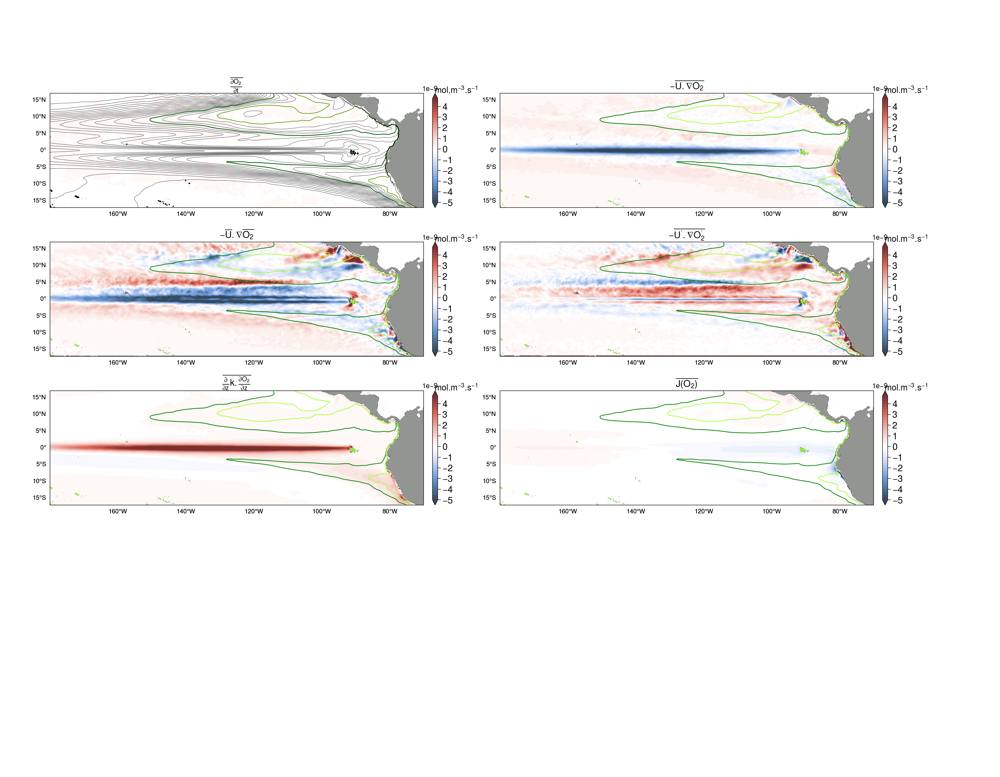

In [8]:
fig = plt.figure(figsize=(18,14),dpi=100)
fs=12; fsx=8
EE=-200.0; WW=-70.1; SS=-17.0; NN=17.1
coor=[EE,WW,SS,NN]; CL=215.0 # central longtiude 
lon_lab=np.concatenate([np.arange(EE,WW,20)])
lat_lab=np.arange(SS+2,NN-1,5)

clr_o2='NegPos'
omz_clr='green'
odz_clr='lime'

VAR= [((dsw.tend_O2*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),
      ((-(dsw.adv_h_O2+dsw.adv_v_O2)*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),
      ((-dsw.DIVd*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),      
      (((-dsw.DIVdp)*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),
      ((-dsw.dif_v_O2*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),
      ((dsw.bio_O2*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),
     ]

units=['mol.m$^{-3}$.s$^{-1}$']
title=[r'$\overline{\frac{\partial{O_2}}{\partial{t}}}$ ', 
     r"$-\overline{U.\nabla{O_2}}$",
     r'$-\overline{U}.\nabla{\overline{O_2}}$ ',
     r"$-\overline{U'.\nabla{O_2'}}$",
     r'$\overline{\frac{\partial{}}{\partial{z}}k.\frac{\partial{O_2}}{\partial{z}}}$ ',
     r'$\overline{J(O_2)}$ ']


clrs=[clr_o2]
lmax=5e-9
lmin=-lmax
lstp=lmax*0.5e-1

gs = fig.add_gridspec(nrows=3, ncols=2, bottom=0.35,left=0.05, right=0.95, wspace=0.0, hspace=0.3)
rng=[0,1,2,3,4,5]
r=[0,0,1,1,2,2]
c=[0,1,0,1,0,1]

for i in tqdm(np.arange(0,6)):#len(VAR))):
    ax = fig.add_subplot(gs[r[i], c[i]] ,projection=ccrs.PlateCarree())
    ax = plot_cmap(ax,dsw.XC,dsw.YC, VAR[i],lmin, lmax, lstp,
                   clrs[0],units[0],title[i],coor,fs,fsx, lon_lab,lat_lab)
#     (dv.UVEL).isel(z_t=15).plot.contour(colors='black',linewidths=0.7,levels=np.arange(-150,150,50))
    ax.contour(dsw.XC,dsw.YC, dsw.TRAC03.isel(Z=15)*1e3,colors=omz_clr,linewidths=0.9,levels=np.arange(60,60.1,5))    
    ax.contour(dsw.XC,dsw.YC, dsw.TRAC03.isel(Z=15)*1e3,colors=odz_clr,linewidths=0.9,levels=np.arange(20,20.1,5)) 
    if i==0: 
        ax.contour(dsw.XC,dsw.YC, dsw.TRAC03.isel(Z=15)*1e3,colors='black',linewidths=0.3,levels=np.arange(0,200.1,10)) 
    gl=ax.gridlines(draw_labels=True)
    gl.xlabel_style = {'size': fsx, 'color': 'black'}; gl.ylabel_style = {'size': fsx, 'color': 'black'}; 
    gl.xlabels_top = False; gl.ylabels_right= False; gl.xlines = False; gl.ylines = False
    gl.xlocator = mticker.FixedLocator(lon_lab); gl.ylocator = mticker.FixedLocator(lat_lab)
    gl.xformatter = LONGITUDE_FORMATTER ; gl.yformatter = LATITUDE_FORMATTER

fig.tight_layout()

100%|██████████| 6/6 [00:31<00:00,  5.25s/it]


<bound method Figure.tight_layout of <Figure size 2500x700 with 12 Axes>>

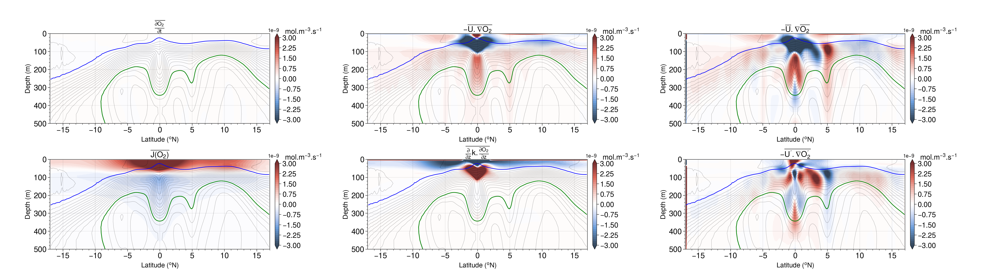

In [9]:
fig = plt.figure(figsize=(25,7),dpi=100,)
gs = fig.add_gridspec(nrows=2, ncols=3, left=0.05, right=0.95, wspace=0.2, hspace=0.4)

fs=14; fsx=8; 
SS=-17; NN=17
tops=0. ; bots=500.; 
coords=[[bots,tops],[SS,NN]]
clr_o2='NegPos'
omz_clr='green'
odz_clr='lime'
om_clr='blue'

var= [((dsw.tend_O2*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),
      ((-(dsw.adv_h_O2+dsw.adv_v_O2)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),
      ((-(dsw.U_dO2+dsw.V_dO2+dsw.W_dO2)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),      
      ((-dsw.DIVdp)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC')/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),      
      ((-dsw.dif_v_O2*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),
      ((dsw.bio_O2*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),
     ]

cntf= True ; cnt= False 
units=['mol.m$^{-3}$.s$^{-1}$']
title=[r'$\overline{\frac{\partial{O_2}}{\partial{t}}}$ ', 
     r"$-\overline{U.\nabla{O_2}}$",
     r'$-\overline{U}.\nabla{\overline{O_2}}$ ',
     r"$-\overline{U'.\nabla{O_2'}}$",
     r'$\overline{\frac{\partial{}}{\partial{z}}k.\frac{\partial{O_2}}{\partial{z}}}$ ',
     r'$\overline{J(O_2)}$ ']

clr=[clr_o2]
lw=0.5; alp=1;cb_on=True

lo = -3e-9; hi = -lo; hi2 = -lo; dsc = -lo*0.5e-1
y=dsw.YC
z= dsw.Z*-1

i=[0,0,0,1,1,1]; j=[0,1,2,2,1,0]
for k in tqdm(np.arange(0,6)):#len(VAR))):
    ax = fig.add_subplot(gs[i[k],j[k]])
    cax= plot_depth_section(ax,y,z,var[k],cntf,np.arange(lo, hi+dsc, dsc),
                            clr[0],units[0],title[k],coords,fs,fsx,lw,alp,cb_on,'lon')
    pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
                     colors='black', alpha=0.5,linewidths=0.3, levels = np.arange(0,300.1,10))
    pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
                     colors=om_clr, alpha=1, linewidths=1, levels = np.arange(200,200.1,0.1))
    pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
                     colors=omz_clr, alpha=1, linewidths=1, levels = np.arange(60,60.1,0.1))
    # pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
    #                  colors=odz_clr, alpha=1, linewidths=1, levels = np.arange(20,20.1,0.1))
    
    
fig.tight_layout

100%|██████████| 6/6 [00:33<00:00,  5.58s/it]


<bound method Figure.tight_layout of <Figure size 2000x1000 with 12 Axes>>

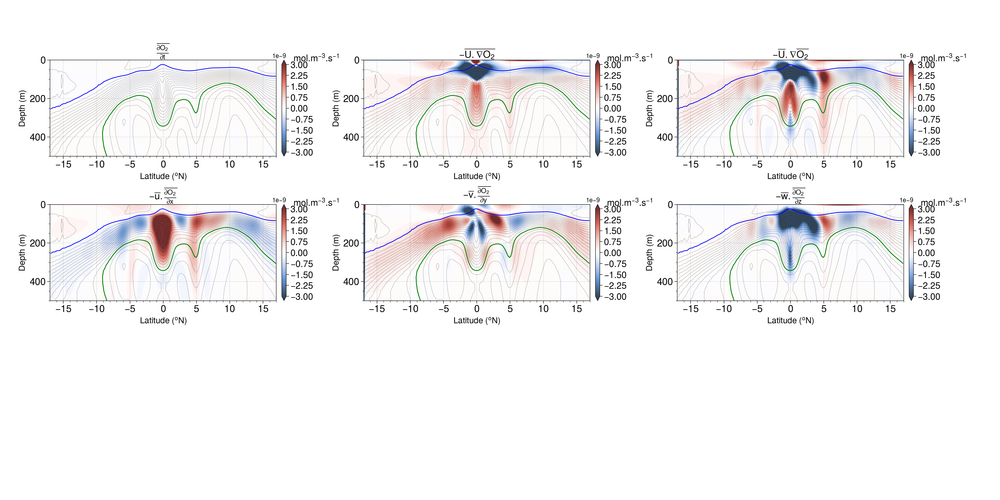

In [10]:
fig = plt.figure(figsize=(20,10),dpi=100,)
gs = fig.add_gridspec(nrows=3, ncols=3, left=0.05, right=0.95, wspace=0.15, hspace=0.5)

# fig = plt.figure(figsize=(25,7),dpi=100,)
# gs = fig.add_gridspec(nrows=2, ncols=3, left=0.05, right=0.95, wspace=0.2, hspace=0.4)

fs=14; fsx=8; 
SS=-17; NN=17
tops=0. ; bots=500.; 
coords=[[bots,tops],[SS,NN]]
clr_o2='NegPos'
omz_clr='green'
odz_clr='lime'
om_clr='blue'

var= [((dsw.tend_O2*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),
      ((-(dsw.adv_h_O2+dsw.adv_v_O2)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),
      ((-(dsw.DIVd)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),        
      ((-(dsw.U_dO2)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),      
      ((-(dsw.V_dO2)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),      
      ((-(dsw.W_dO2)*dsw.rVOL).sel(XC=slice(360-W,360-E)).sum('XC'))/(dsw.rVOL.sel(XC=slice(360-W,360-E)).sum('XC')),      
       ]

cntf= True ; cnt= False 
units=['mol.m$^{-3}$.s$^{-1}$']
title=[r'$\overline{\frac{\partial{O_2}}{\partial{t}}}$ ', 
     r"$-\overline{U.\nabla{O_2}}$",
     r'$-\overline{U}.\nabla{\overline{O_2}}$ ',
     r'$-\overline{u}.\overline{\frac{\partial{O_2}}{\partial{x}}}$ ',
     r'$-\overline{v}.\overline{\frac{\partial{O_2}}{\partial{y}}}$ ',
     r'$-\overline{w}.\overline{\frac{\partial{O_2}}{\partial{z}}}$ ',]

clr=[clr_o2]
lw=0.5; alp=1;cb_on=True

lo = -3e-9; hi = -lo; hi2 = -lo; dsc = -lo*0.5e-1
y=dsw.YC
z= dsw.Z*-1

i=[0,0,0,1,1,1]; j=[0,1,2,0,1,2]
for k in tqdm(np.arange(0,6)):#len(VAR))):
    ax = fig.add_subplot(gs[i[k],j[k]])
    cax= plot_depth_section(ax,y,z,var[k],cntf,np.arange(lo, hi+dsc, dsc),
                            clr[0],units[0],title[k],coords,fs,fsx,lw,alp,cb_on,'lon')
    pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
                     colors='black', alpha=0.5,linewidths=0.3, levels = np.arange(0,300.1,10))
    pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
                     colors=om_clr, alpha=1, linewidths=1, levels = np.arange(200,200.1,0.1))
    pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
                     colors=omz_clr, alpha=1, linewidths=1, levels = np.arange(60,60.1,0.1))
    # pch= cax.contour(y, z,dsw.TRAC03.sel(XC=slice(360-W,360-E)).mean({'XC'})*1e3,
    #                  colors=odz_clr, alpha=1, linewidths=1, levels = np.arange(20,20.1,0.1))
    

fig.tight_layout

# Plot Seasonal Cycle

In [13]:
do=((dst*dsw.rVOL).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sel(Z=slice(Du,Dl)).sum({'XC','YC','Z'})).compute()

In [14]:
dswz=(((dst*dsw.rVOL).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC'}))/((dsw.rVOL).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC'}))).compute()

In [15]:
Uz=((dsv.UVEL).sel(XG=slice(360-W,360-E)).sel(YC=slice(S,N)).mean({'XG','YC'}))
Uzm=Uz.groupby('time.month').mean(dim='time').compute()
Vz=((dsv.VVEL).sel(XC=slice(360-W,360-E)).sel(YG=slice(S,N)).mean({'XC','YG'}))
Vzm=Vz.groupby('time.month').mean(dim='time').compute()
Wz=((dsv.WVEL).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).mean({'XC','YC'}))
Wzm=Wz.groupby('time.month').mean(dim='time').compute()

In [16]:
EKE_m=((EKE*dsw.rA).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC'}))/(dsw.rA.sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC'}))
EKE_mn=EKE_m.groupby('time.month').mean(dim='time').compute()
EKEz_m=((EKE*dsw.rA).sel(XC=slice(360-W,360-E)).sum({'XC'}))/(dsw.rA.sel(XC=slice(360-W,360-E)).sum({'XC'}))
EKEz_mn=EKEz_m.groupby('time.month').mean(dim='time').compute()

100%|██████████| 6/6 [00:00<00:00,  7.30it/s]


Text(0.5, 1.0, '$\\overline{EKE}$')

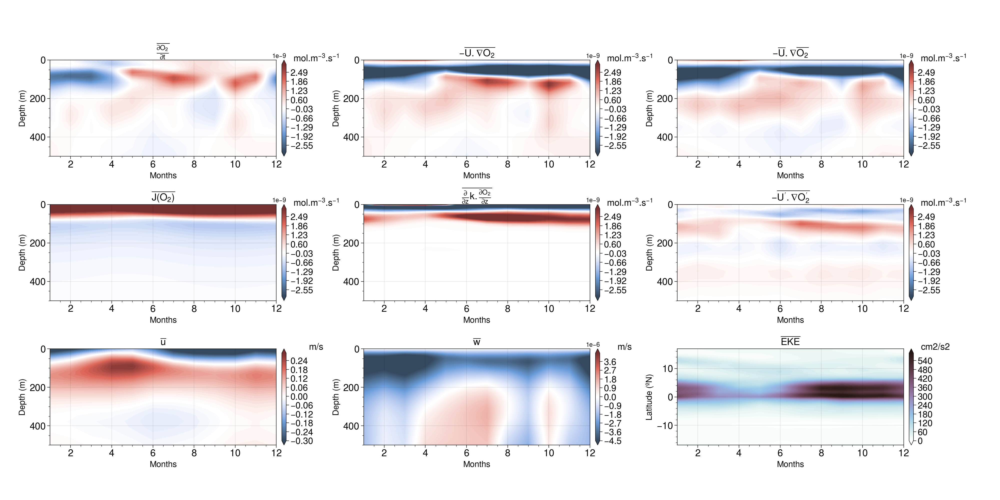

In [15]:
fig = plt.figure(figsize=(20,10),dpi=100,)
gs = fig.add_gridspec(nrows=3, ncols=3, left=0.05, right=0.95, wspace=0.15, hspace=0.5)

fs=14; fsx=8; 
SS=-17; NN=17
tops=0. ; bots=500.; 
coords=[[bots,tops],[SS,NN]]
clr_o2='NegPos'
omz_clr='green'
odz_clr='lime'
om_clr='blue'

var= [dswz.tend_O2,
      -dswz.adv_h_O2-dswz.adv_v_O2,
      -dswz.DIVd,
      -dswz.DIVdp,
      -dswz.dif_v_O2,
      dswz.bio_O2,
     ]

cntf= True ; cnt= False 
units=['mol.m$^{-3}$.s$^{-1}$']
title=[r'$\overline{\frac{\partial{O_2}}{\partial{t}}}$ ', 
     r"$-\overline{U.\nabla{O_2}}$",
     r'$-\overline{U}.\nabla{\overline{O_2}}$ ',
     r"$-\overline{U'.\nabla{O_2'}}$",
     r'$\overline{\frac{\partial{}}{\partial{z}}k.\frac{\partial{O_2}}{\partial{z}}}$ ',
     r'$\overline{J(O_2)}$ ']

clr=[clr_o2]
lw=0.5; alp=1;cb_on=True

lo = -3e-9; hi = -lo; hi2 = -lo; dsc = -lo*0.3e-1
y=dswz.month
z= dswz.Z*-1

i=[0,0,0,1,1,1]; j=[0,1,2,2,1,0]
for k in tqdm(np.arange(0,6)):#len(VAR))):
    ax = fig.add_subplot(gs[i[k],j[k]])
    cs= ax.contourf(y,z,var[k].transpose(),levels=np.arange(lo, hi+dsc, dsc),cmap=clr[0],extend='both')
    cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
    cb.set_label(units[0], rotation=0,size=fs-1,position=(1,1.06))
    cb.ax.tick_params(labelsize=fs-1)
    cb.ax.minorticks_off()
    # cs= ax.contour(y,z,dso.transpose()*1e3,colors='k',linewidths=lw,alpha=alp)
    ax.set_ylim(coords[0]); ax.minorticks_on(); 
    # ax.set_xlim(coords[1]); 
    ax.set_ylabel('Depth (m)',fontsize=fs-2); 
    ax.set_aspect('auto')
    ax.set_xlabel('Months',fontsize=fs-2)
    ax.tick_params(axis='both', labelsize=fs)  
    ax.set_title(title[k],loc='center',fontsize=fs)

fig.tight_layout


ax = fig.add_subplot(gs[2,0])
cs= ax.contourf(y,z,Uzm.transpose(),levels=np.arange(-0.3,0.3,0.01),cmap=clr[0],extend='both')
cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
cb.set_label('m/s', rotation=0,size=fs-1,position=(1,1.06))
cb.ax.tick_params(labelsize=fs-1)
cb.ax.minorticks_off()
ax.set_ylim(coords[0]); ax.minorticks_on(); 
ax.set_ylabel('Depth (m)',fontsize=fs-2); 
ax.set_aspect('auto')
ax.set_xlabel('Months',fontsize=fs-2)
ax.tick_params(axis='both', labelsize=fs)  
ax.set_title('$\overline{u}$',loc='center',fontsize=fs)

ax = fig.add_subplot(gs[2,1])
cs= ax.contourf(y,-Wzm.Zl,-Wzm.transpose(),levels=np.arange(-4.5e-6,4.5e-6,0.05e-6),cmap=clr[0],extend='both') #
cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
cb.set_label('m/s', rotation=0,size=fs-1,position=(1,1.06))
cb.ax.tick_params(labelsize=fs-1)
cb.ax.minorticks_off()
ax.set_ylim(coords[0]); ax.minorticks_on(); 
ax.set_ylabel('Depth (m)',fontsize=fs-2); 
ax.set_aspect('auto')
ax.set_xlabel('Months',fontsize=fs-2)
ax.tick_params(axis='both', labelsize=fs)  
ax.set_title('$\overline{w}$',loc='center',fontsize=fs)

ax = fig.add_subplot(gs[2,2])
cs= ax.contourf(EKEz_mn.month,EKEz_mn.YC,EKEz_mn.transpose()*1e4,levels=np.arange(0,0.6e3,0.01e3),cmap='glacial',extend='both') #
cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
cb.set_label('cm2/s2', rotation=0,size=fs-1,position=(1,1.06))
cb.ax.tick_params(labelsize=fs-1)
cb.ax.minorticks_off()
# ax.set_ylim(coords[0]); ax.minorticks_on(); 
ax.set_ylabel('Latitude (ºN)',fontsize=fs-2); 
ax.set_aspect('auto')
ax.set_xlabel('Months',fontsize=fs-2)
ax.tick_params(axis='both', labelsize=fs)  
ax.set_title('$\overline{EKE}$',loc='center',fontsize=fs)


100%|██████████| 6/6 [00:00<00:00, 13.06it/s]


Text(0.5, 1.0, '$\\overline{w}$')

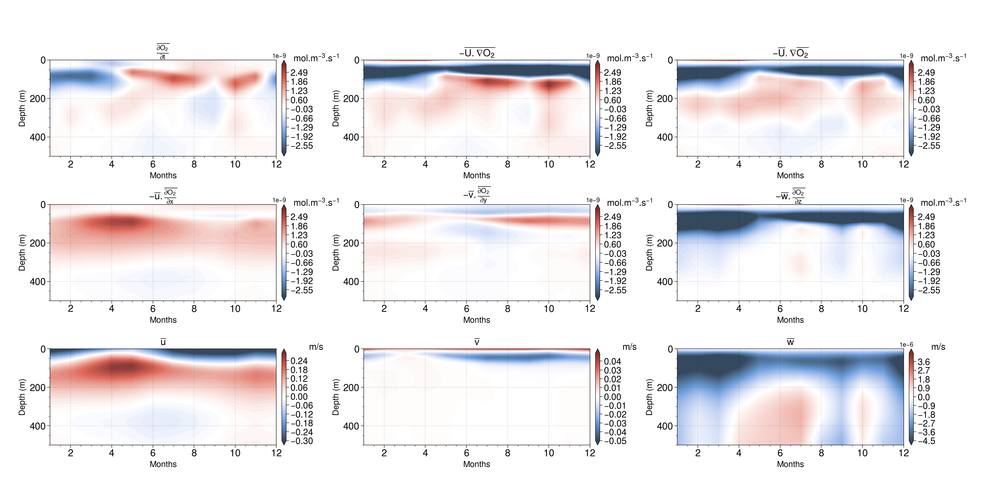

In [16]:
fig = plt.figure(figsize=(20,10),dpi=100,)
gs = fig.add_gridspec(nrows=3, ncols=3, left=0.05, right=0.95, wspace=0.15, hspace=0.5)

fs=14; fsx=8; 
SS=-17; NN=17
tops=0. ; bots=500.; 
coords=[[bots,tops],[SS,NN]]
clr_o2='NegPos'
omz_clr='green'
odz_clr='lime'
om_clr='blue'

var= [dswz.tend_O2,
      -dswz.adv_h_O2-dswz.adv_v_O2,
      -dswz.DIVd,
      -dswz.U_dO2,
      -dswz.V_dO2,
      -dswz.W_dO2,]

cntf= True ; cnt= False 
units=['mol.m$^{-3}$.s$^{-1}$']
title=[r'$\overline{\frac{\partial{O_2}}{\partial{t}}}$ ', 
     r"$-\overline{U.\nabla{O_2}}$",
     r'$-\overline{U}.\nabla{\overline{O_2}}$ ',
     r'$-\overline{u}.\overline{\frac{\partial{O_2}}{\partial{x}}}$ ',
     r'$-\overline{v}.\overline{\frac{\partial{O_2}}{\partial{y}}}$ ',
     r'$-\overline{w}.\overline{\frac{\partial{O_2}}{\partial{z}}}$ ',]

clr=[clr_o2]
lw=0.5; alp=1;cb_on=True

lo = -3e-9; hi = -lo; hi2 = -lo; dsc = -lo*0.3e-1
y=dswz.month
z= dswz.Z*-1

i=[0,0,0,1,1,1]; j=[0,1,2,0,1,2]
for k in tqdm(np.arange(0,6)):#len(VAR))):
    ax = fig.add_subplot(gs[i[k],j[k]])
    cs= ax.contourf(y,z,var[k].transpose(),levels=np.arange(lo, hi+dsc, dsc),cmap=clr[0],extend='both')
    cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
    cb.set_label(units[0], rotation=0,size=fs-1,position=(1,1.06))
    cb.ax.tick_params(labelsize=fs-1)
    cb.ax.minorticks_off()
    # cs= ax.contour(y,z,dso.transpose()*1e3,colors='k',linewidths=lw,alpha=alp)
    ax.set_ylim(coords[0]); ax.minorticks_on(); 
    # ax.set_xlim(coords[1]); 
    ax.set_ylabel('Depth (m)',fontsize=fs-2); 
    ax.set_aspect('auto')
    ax.set_xlabel('Months',fontsize=fs-2)
    ax.tick_params(axis='both', labelsize=fs)  
    ax.set_title(title[k],loc='center',fontsize=fs)

fig.tight_layout


ax = fig.add_subplot(gs[2,0])
cs= ax.contourf(y,z,Uzm.transpose(),levels=np.arange(-0.3,0.3,0.01),cmap=clr[0],extend='both')
cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
cb.set_label('m/s', rotation=0,size=fs-1,position=(1,1.06))
cb.ax.tick_params(labelsize=fs-1)
cb.ax.minorticks_off()
ax.set_ylim(coords[0]); ax.minorticks_on(); 
ax.set_ylabel('Depth (m)',fontsize=fs-2); 
ax.set_aspect('auto')
ax.set_xlabel('Months',fontsize=fs-2)
ax.tick_params(axis='both', labelsize=fs)  
ax.set_title('$\overline{u}$',loc='center',fontsize=fs)


ax = fig.add_subplot(gs[2,1])
cs= ax.contourf(y,z,Vzm.transpose(),levels=np.arange(-0.05,0.05,0.001),cmap=clr[0],extend='both')
cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
cb.set_label('m/s', rotation=0,size=fs-1,position=(1,1.06))
cb.ax.tick_params(labelsize=fs-1)
cb.ax.minorticks_off()
ax.set_ylim(coords[0]); ax.minorticks_on(); 
ax.set_ylabel('Depth (m)',fontsize=fs-2); 
ax.set_aspect('auto')
ax.set_xlabel('Months',fontsize=fs-2)
ax.tick_params(axis='both', labelsize=fs)  
ax.set_title('$\overline{v}$',loc='center',fontsize=fs)

ax = fig.add_subplot(gs[2,2])
cs= ax.contourf(y,-Wzm.Zl,-Wzm.transpose(),levels=np.arange(-4.5e-6,4.5e-6,0.05e-6),cmap=clr[0],extend='both') #
cb = plt.colorbar(cs, ax=ax, orientation='vertical', extend='both',pad=0.02)#, aspect=20)  
cb.set_label('m/s', rotation=0,size=fs-1,position=(1,1.06))
cb.ax.tick_params(labelsize=fs-1)
cb.ax.minorticks_off()
ax.set_ylim(coords[0]); ax.minorticks_on(); 
ax.set_ylabel('Depth (m)',fontsize=fs-2); 
ax.set_aspect('auto')
ax.set_xlabel('Months',fontsize=fs-2)
ax.tick_params(axis='both', labelsize=fs)  
ax.set_title('$\overline{w}$',loc='center',fontsize=fs)


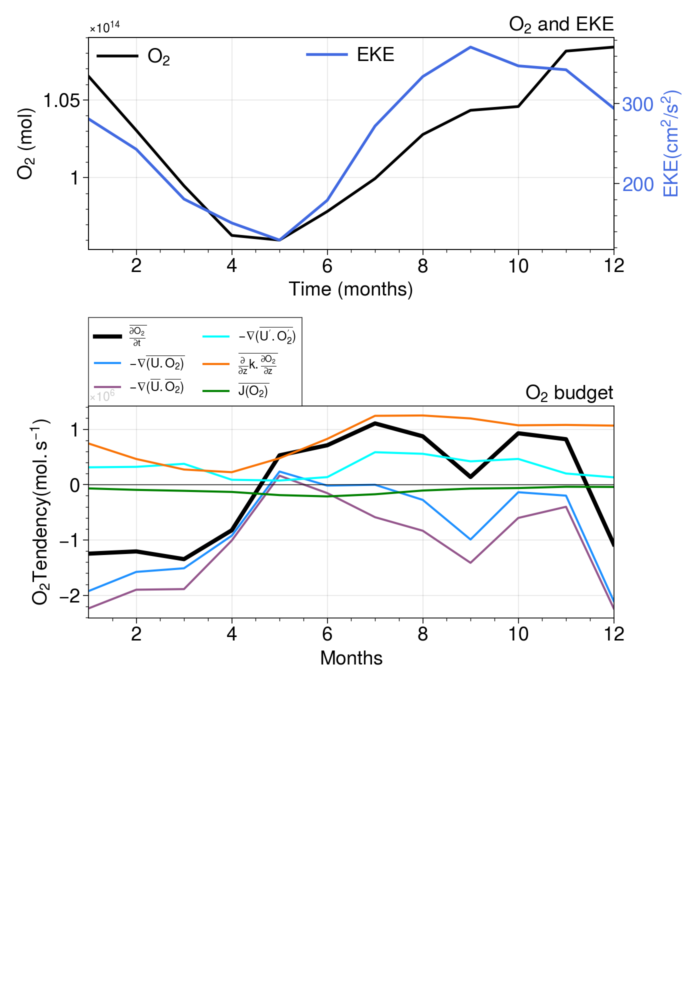

In [17]:
fig = plt.figure(figsize=(7,10),dpi=100, facecolor='white')
fs=14
gs2 = fig.add_gridspec(nrows=3, ncols=1)#, top=0.3, left=0.38, right=0.95, wspace=0.4, hspace=0.2)    

ax = fig.add_subplot(gs2[0,0])
pc=ax.plot(dst.month,do.TRAC03,color='black', Linewidth=2,label='O$_2$')
ax.set_xlim([0., 13.])

ax.minorticks_on()
ax.set_xlabel('Time (months)',fontsize=fs)
ax.xaxis.set_ticks_position('bottom')
ax.set_ylabel(r'O$_2$ (mol)',fontsize=fs)
ax.set_title(r'O$_2$ and EKE',fontsize=fs,loc='right')
ax.tick_params(axis='both', which='major', labelsize=fs)
plt.legend(loc='upper left',fontsize=fs,frameon=False)

ax2 = ax.twinx()
color = 'royalblue'
ax2.set_ylabel('EKE(cm$^2$/s$^2$)', color=color,fontsize=fs)  
ax2.plot(dst.month,EKE_mn*1e4,color=color,Linewidth=2,label='EKE') 
ax2.tick_params(axis='y', labelcolor=color)
ax2.tick_params(axis='both', which='major', labelsize=fs)
ax2.grid(False)
plt.xlim(1,12)
plt.legend(loc='upper center',fontsize=fs,frameon=False)


VARS=[do.tend_O2,
      -do.adv_h_O2-do.adv_v_O2,
      -do.DIVd,
      -do.DIVdp,
      -do.dif_v_O2,
      do.bio_O2,]

title=[r' $\overline{\frac{\partial{O_2}}{\partial{t}}}$ ', 
     r' $-\nabla{\overline{(U.O_2)}}$ ',
     r' $-\nabla{(\overline{U}.\overline{O_2})}$ ',
     r" $-\nabla{(\overline{U'.O_2'})}$",
     r' $\overline{\frac{\partial{}}{\partial{z}}k.\frac{\partial{O_2}}{\partial{z}}}$ ',
     r' $\overline{J(O_2)}$ ',]

clr=['black','dodgerblue','purple','cyan','orange','green']#

ax = fig.add_subplot(gs2[1,0])

i=0
for VAR in VARS:
    if i==0: LWW=3
    if i>0: LWW=1.5
    ax.plot(dst.month,VAR,
               label=str(title[i]), color=clr[i],lw=LWW)
    i+=1

ax.legend(bbox_to_anchor=(0, 1), loc='lower left', ncol=2)
ax.set_title('O$_2$ budget',size=14,loc='right')# integrated over '+str(abs(Wi))+'W-'+str(abs(Ei))+'W '+str(top)+'-'+str(bot)+'m')
ax.set_ylabel(r'O$_2 Tendency (mol.s^{-1})$',fontsize=14)
ax.set_xlabel('Months',fontsize=14)
ax.axhline(y=0.0, color='k',lw=0.5)
ax.minorticks_on()
ax.xaxis.set_ticks_position('bottom')
# ax.set_title('b) ',fontsize=fs+1,loc='left')
ax.tick_params(axis='both', which='major', labelsize=fs)
# plt.legend(loc='upper left',fontsize=fs,frameon=False)
plt.xlim(1,12)

plt.tight_layout()

# Plot Interannual Variability in Budget Terms and ENSO Influence

In [17]:
dsbd=((dsb*dsw.rVOL).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sel(Z=slice(Du,Dl)).sum({'XC','YC','Z'})).compute()
dsbd

<xarray.Dataset>
Dimensions:   (time: 584)
Coordinates:
    iter      (time) int32 105360 105600 105840 106080 ... 245040 245280 245520
  * time      (time) datetime64[ns] 2010-01-04 2010-01-09 ... 2017-12-28
Data variables:
    adv_h_O2  (time) float32 -1.94e+06 -2.179e+06 ... -2.351e+06 -2.856e+06
    adv_v_O2  (time) float32 2.19e+06 2.691e+06 ... 1.457e+06 2.583e+06
    bio_O2    (time) float32 319.8 8.645e+03 2.939e+03 ... -3.476e+04 -3.839e+04
    dif_h_O2  (time) float32 2.984e+03 3.961e+03 ... -3.585e+03 -2.236e+03
    dif_v_O2  (time) float32 -6.899e+05 -7.536e+05 ... -8.389e+05 -9.017e+05
    surf_O2   (time) float32 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0 0.0
    tend_O2   (time) float32 4.374e+05 2.463e+05 ... 1.701e+06 1.139e+06
    adv_huO2  (time) float32 -3.261e+06 -1.431e+06 ... -4.091e+06 -5.342e+06
    adv_vwO2  (time) float32 3.511e+06 1.944e+06 ... 3.197e+06 5.068e+06
    rVOL      (time) float32 3.228e+24 3.228e+24 ... 3.228e+24 3.228e+24

In [20]:
Nn=5
Sn=-5
Wn=170
En=120
nino34=(((dsv['THETA'].isel(Z=0)*dsw.rA).sel(XC=slice(360-Wn,360-En)).sel(YC=slice(Sn,Nn)).sum({'XC','YC'}))/(dsw.rA.sel(XC=slice(360-Wn,360-En)).sel(YC=slice(Sn,Nn)).sum({'XC','YC'}))).compute()

(14641.0, 17440.0)

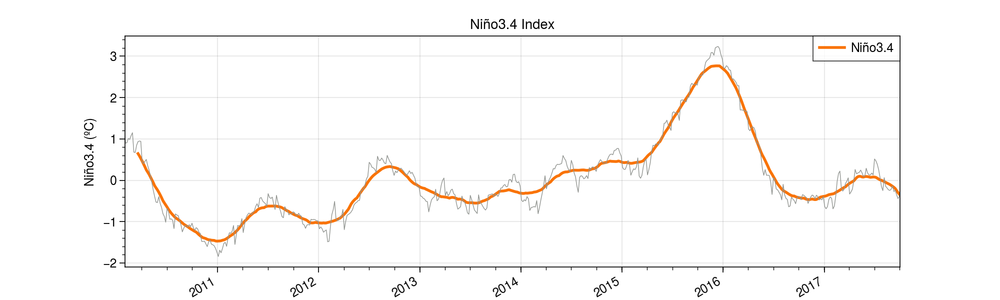

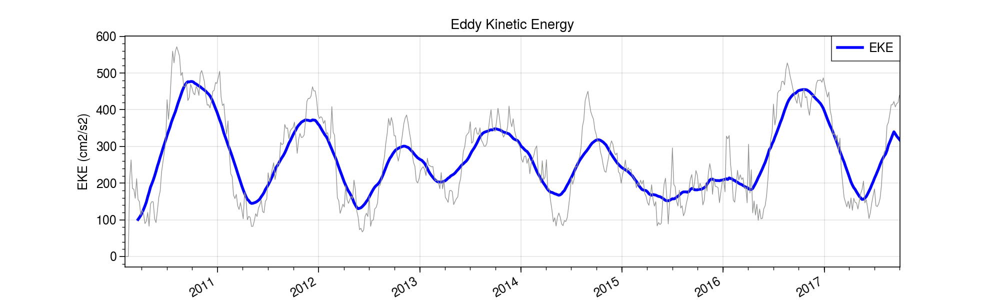

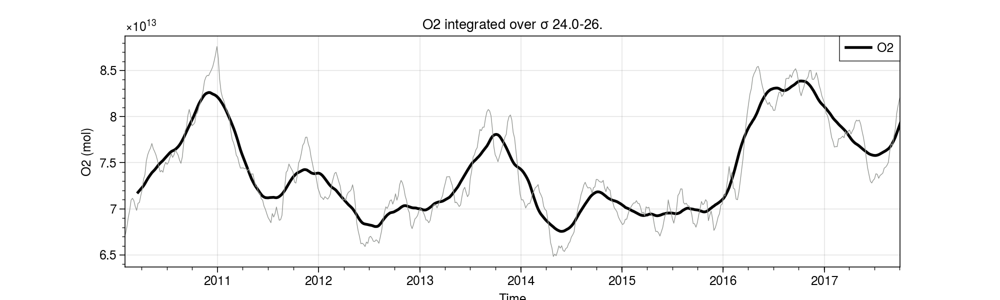

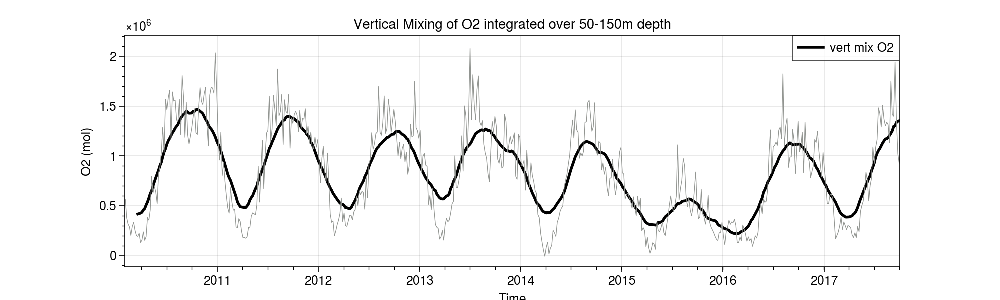

In [23]:
rm=6*5
anomaly(nino34).rolling(time=rm,center=True).mean().plot(figsize=(10,3),color='orange',lw=2,label='Niño3.4')
anomaly(nino34).plot(color='grey',lw=0.5)
plt.title('Niño3.4 Index')
plt.xlabel('Time')
plt.ylabel('Niño3.4 (ºC)')
plt.xlim(['2010-02','2017-10'])
plt.legend()

(EKE_m*1e4).rolling(time=rm,center=True).mean().plot(figsize=(10,3),color='blue',lw=2,label='EKE')
(EKE_m*1e4).plot(color='grey',lw=0.5)
plt.legend()
plt.title('Eddy Kinetic Energy')
plt.xlabel('Time')
plt.ylabel('EKE (cm2/s2)')
plt.xlim(['2010-02','2017-10'])

fig = plt.figure(figsize=(10,3),dpi=100, facecolor='white')
plt.plot(O2_rho.time,O2_rho.rolling(time=rm,center=True).mean(),lw=2,label='O2',color='black')
plt.plot(O2_rho.time,O2_rho,lw=0.5,color='grey')
plt.legend()
plt.title('O2 integrated over $\sigma$ '+str(rho_u-1e3)[:4]+'-'+str(rho_d-1e3)[:3])
plt.xlabel('Time')
plt.ylabel('O2 (mol)')
plt.xlim(['2010-02','2017-10'])

fig = plt.figure(figsize=(10,3),dpi=100, facecolor='white')
plt.plot(O2_rho.time,-dsbd.dif_v_O2.rolling(time=rm,center=True).mean(),lw=2,
         label='vert mix O2',color='orange')
plt.plot(O2_rho.time,-dsbd.dif_v_O2,lw=0.5,color='grey')
plt.legend()
plt.title('Vertical Mixing of O2 integrated over 50-150m depth')
plt.xlabel('Time')
plt.ylabel('tendency O2 (mol/s)')
plt.xlim(['2010-02','2017-10'])

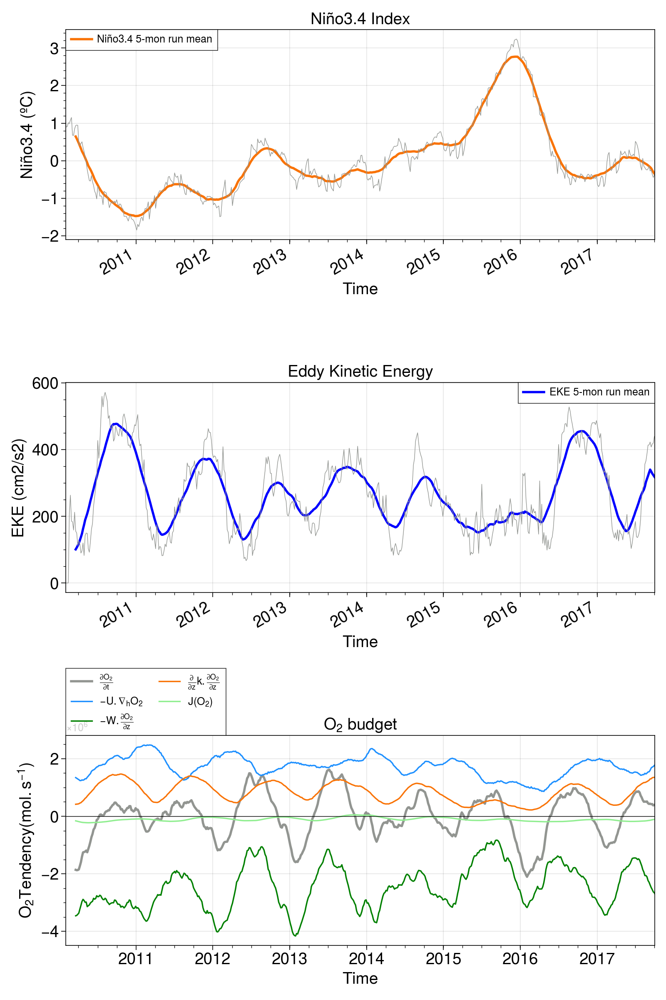

In [89]:
fig = plt.figure(figsize=(8,12),dpi=100, facecolor='white')
fs=14

rm=6*5

gs2 = fig.add_gridspec(nrows=3, ncols=1)#, top=0.3, left=0.38, right=0.95, wspace=0.4, hspace=0.2)    

ax = fig.add_subplot(gs2[0,0])
anomaly(nino34).rolling(time=rm,center=True).mean().plot(color='orange',lw=2,label='Niño3.4 '+str(rm/6)[0]+'-mon run mean')
plt.legend()
anomaly(nino34).plot(color='grey',lw=0.5)
plt.title('Niño3.4 Index',fontsize=14)
plt.ylabel('Niño3.4 (ºC)',fontsize=14)
plt.xlabel('Time',fontsize=14)
plt.xlim(['2010-02','2017-10'])
plt.tick_params(axis='both', which='major', labelsize=fs)

ax = fig.add_subplot(gs2[1,0])
# (anomaly(EKE_m)*1e4).rolling(time=rm,center=True).mean().plot(color='blue',lw=2,label='EKE '+str(rm/6)[0]+'-mon run mean')
# (anomaly(EKE_m)*1e4).plot(color='grey',lw=0.5)
((EKE_m)*1e4).rolling(time=rm,center=True).mean().plot(color='blue',lw=2,label='EKE '+str(rm/6)[0]+'-mon run mean')
((EKE_m)*1e4).plot(color='grey',lw=0.5)

plt.legend()
plt.title('Eddy Kinetic Energy',fontsize=14)
plt.ylabel('EKE (cm2/s2)',fontsize=14)
plt.xlabel('Time',fontsize=14)
plt.xlim(['2010-02','2017-10'])
plt.tick_params(axis='both', which='major', labelsize=fs)

# ax = fig.add_subplot(gs2[2,0])
# plt.plot(O2_rho.time,O2_rho.rolling(time=rm,center=True).mean(),lw=2,label='O2',color='black')
# plt.plot(O2_rho.time,O2_rho,lw=0.5,color='grey')
# plt.legend()
# plt.title('O2 integrated over $\sigma$ '+str(rho_u-1e3)[:4]+'-'+str(rho_d-1e3)[:3],fontsize=14)
# plt.ylabel('O2 (mol)',fontsize=14)
# plt.xlabel('Time',fontsize=14)
# plt.xlim(['2010-02','2017-10'])
# plt.tick_params(axis='both', which='major', labelsize=fs)

# ax = fig.add_subplot(gs2[2,0])
# plt.plot(O2_rho.time,-dsbd.dif_v_O2.rolling(time=rm,center=True).mean(),lw=2,
#          label='vert mix O2',color='orange')
# plt.plot(O2_rho.time,-dsbd.dif_v_O2,lw=0.5,color='grey')
# plt.legend()
# plt.title('Vertical Mixing of O2 integrated over 50-150m depth',fontsize=14)
# plt.ylabel('tendency O2 (mol/s)',fontsize=14)
# plt.xlabel('Time',fontsize=14)
# plt.xlim(['2010-02','2017-10'])
# plt.tick_params(axis='both', which='major', labelsize=fs)


VARS=[dsbd.tend_O2,
      -dsbd.adv_h_O2,
      -dsbd.adv_v_O2,
      -dsbd.dif_v_O2,
      dsbd.bio_O2,
     ]

title=[r' $\frac{\partial{O_2}}{\partial{t}}$ ', 
     r' $-U.\nabla_h{O_2}$ ',
     r' $-W.\frac{\partial{O_2}}{\partial{z}}$ ',
     r' $\frac{\partial{}}{\partial{z}}k.\frac{\partial{O_2}}{\partial{z}}$ ',
     r' $J(O_2)$ ',
      ]

clr=['grey',
     'dodgerblue',
     'green',
     'orange',
     'lightgreen',
    ]

ax = fig.add_subplot(gs2[2,0])

i=0
for VAR in VARS[:]:
    if i==0: LWW=2.0
    if i>0: LWW=1.2
    # ax.plot(dsv.time,anomaly(VAR).rolling(time=rm,center=True).mean(),label=str(title[i]), color=clr[i],lw=LWW)
    ax.plot(dsv.time,(VAR).rolling(time=rm,center=True).mean(),label=str(title[i]), color=clr[i],lw=LWW)
    i+=1

ax.legend(bbox_to_anchor=(0, 1), loc='lower left', ncol=2)
ax.set_title('O$_2$ budget',size=14,loc='center')# integrated over '+str(abs(Wi))+'W-'+str(abs(Ei))+'W '+str(top)+'-'+str(bot)+'m')
ax.set_ylabel(r'O$_2 Tendency (mol.s^{-1})$',fontsize=14)
ax.set_xlabel('Time',fontsize=14)
ax.axhline(y=0.0, color='k',lw=0.5)
ax.minorticks_on()
ax.xaxis.set_ticks_position('bottom')
# ax.set_title('b) ',fontsize=fs+1,loc='left')
# plt.legend(loc='upper left',fontsize=fs,frameon=True)
# plt.ylim(-5e6,3.0e6)
plt.xlim(['2010-02','2017-10'])
plt.tick_params(axis='both', which='major', labelsize=fs)

plt.tight_layout()

100%|██████████| 3/3 [01:12<00:00, 24.11s/it]


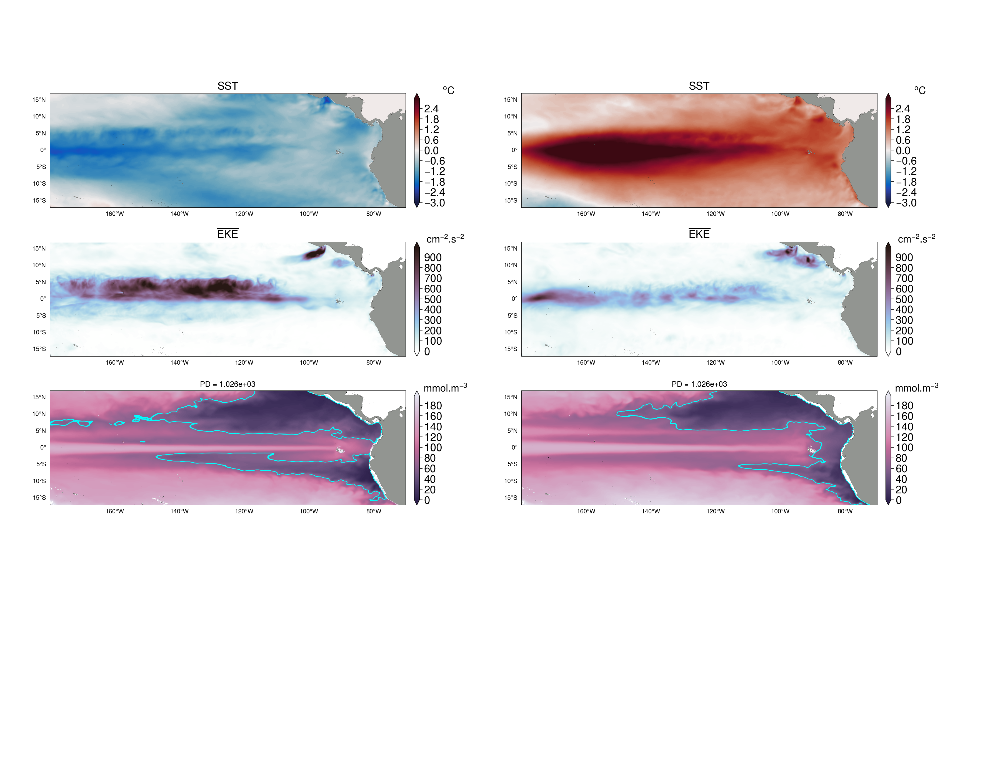

In [93]:
fig = plt.figure(figsize=(18,14),dpi=100)
fs=14; fsx=8
EE=-200.0; WW=-70.1; SS=-17.0; NN=17.1
coor=[EE,WW,SS,NN]; CL=215.0 # central longtiude 
lon_lab=np.concatenate([np.arange(EE,WW,20)])
lat_lab=np.arange(SS+2,NN-1,5)

VAR= [
    anomaly(dsv.THETA.isel(Z=0)),
    EKE*1e4,
    # ((dsv.TRAC03*1e3*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),
    dso.TRAC03.sel(PD=1026.0)*1e3,
    ]

units=['$^{o}$C',
      'cm$^{-2}$.s$^{-2}$',
      'mmol.m$^{-3}$',
      'mmol.m$^{-3}$',]
title=['SST',r'$\overline{EKE}$ ','O2 50-150m','O2 on 24.5']
clrs=['cmo.balance','glacial','acton','acton']
lmax=[3,10e2,200,200]
lmin=[-3,0,0,0]
lstp=[3e-2,5,200e-2,200e-2]

gs = fig.add_gridspec(nrows=3, ncols=2, bottom=0.35,left=0.05, right=0.95, wspace=0.1, hspace=0.3)
rng=[0,1,2,3,4,5]
r=[0,1,2,0,1,2]
c=[0,0,0,1,1,1]

t1='2010-10'
t2='2011-02'

for i in tqdm(np.arange(0,3)):#len(VAR))):
    ax = fig.add_subplot(gs[r[i], c[i]] ,projection=ccrs.PlateCarree())
    ax = plot_cmap(ax,dsw.XC,dsw.YC, VAR[i].sel(time=slice(t1,t2)).mean('time'),lmin[i], lmax[i], lstp[i],
                   clrs[i],units[i],title[i],coor,fs,fsx, lon_lab,lat_lab)    
    if i>1:
        VAR[i].sel(time=slice(t1,t2)).mean('time').plot.contour(x='XC', y='YC',vmin=60, vmax=61, colors='cyan', linewidths=0.6,)

t1='2015-10'
t2='2016-02'
rng=[0,1,2,3,4,5]
r=[0,1,2,0,1,2]
c=[1,1,1,1,1,1]
for i in tqdm(np.arange(0,3)):#len(VAR))):
    ax = fig.add_subplot(gs[r[i], c[i]] ,projection=ccrs.PlateCarree())
    ax = plot_cmap(ax,dsw.XC,dsw.YC, VAR[i].sel(time=slice(t1,t2)).mean('time'),lmin[i], lmax[i], lstp[i],
                   clrs[i],units[i],title[i],coor,fs,fsx, lon_lab,lat_lab)    
    if i>1:
        VAR[i].sel(time=slice(t1,t2)).mean('time').plot.contour(x='XC', y='YC',vmin=60, vmax=61, colors='cyan', linewidths=0.6,)
            

100%|██████████| 3/3 [01:02<00:00, 20.68s/it]


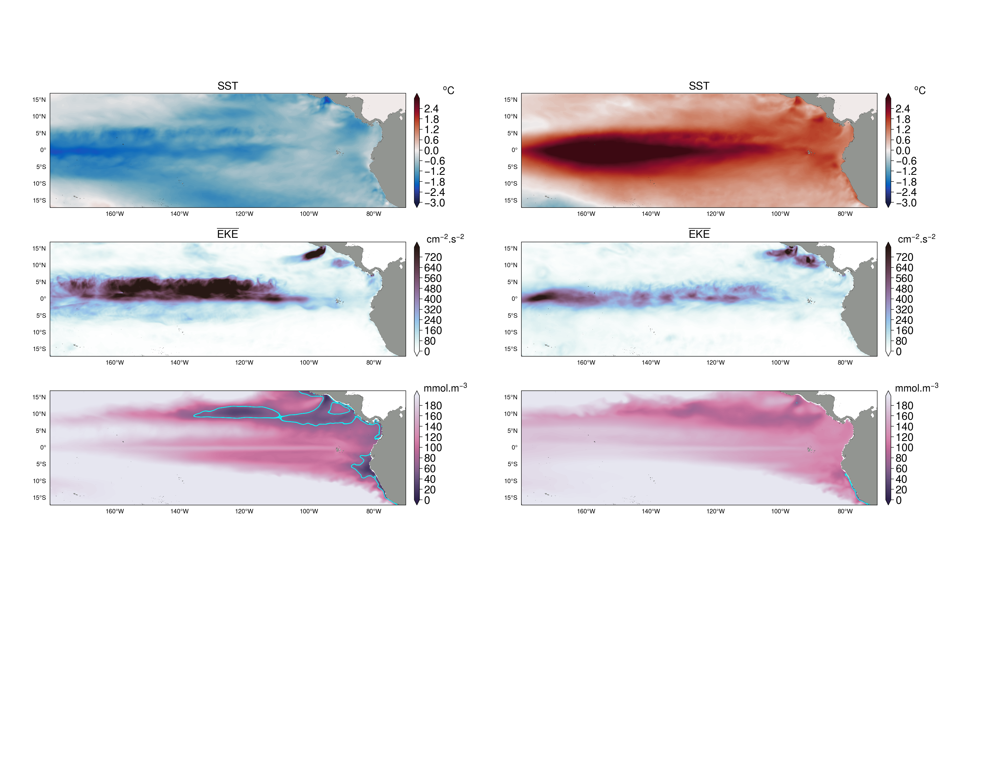

In [91]:
fig = plt.figure(figsize=(18,14),dpi=100)
fs=14; fsx=8
EE=-200.0; WW=-70.1; SS=-17.0; NN=17.1
coor=[EE,WW,SS,NN]; CL=215.0 # central longtiude 
lon_lab=np.concatenate([np.arange(EE,WW,20)])
lat_lab=np.arange(SS+2,NN-1,5)

VAR= [
    anomaly(dsv.THETA.isel(Z=0)),
    EKE*1e4,
    # ((dsv.TRAC03*1e3*dsw.rVOL).sel(Z=slice(Du,Dl)).sum('Z'))/(dsw.rVOL.sel(Z=slice(Du,Dl)).sum('Z')),
    dso.TRAC03.sel(PD=1026.0)*1e3,
    ]

units=['$^{o}$C',
      'cm$^{-2}$.s$^{-2}$',
      'mmol.m$^{-3}$',
      'mmol.m$^{-3}$',]
title=['SST',r'$\overline{EKE}$ ','O2 50-150m','O2 on 24.5']
clrs=['cmo.balance','glacial','acton','acton']
lmax=[3,10e2,200,200]
lmin=[-3,0,0,0]
lstp=[3e-2,5,200e-2,200e-2]

gs = fig.add_gridspec(nrows=3, ncols=2, bottom=0.35,left=0.05, right=0.95, wspace=0.1, hspace=0.3)
rng=[0,1,2,3,4,5]
r=[0,1,2,0,1,2]
c=[0,0,0,1,1,1]

t1='2010-10'
t2='2011-02'

for i in tqdm(np.arange(0,3)):#len(VAR))):
    ax = fig.add_subplot(gs[r[i], c[i]] ,projection=ccrs.PlateCarree())
    ax = plot_cmap(ax,dsw.XC,dsw.YC, VAR[i].sel(time=slice(t1,t2)).mean('time'),lmin[i], lmax[i], lstp[i],
                   clrs[i],units[i],title[i],coor,fs,fsx, lon_lab,lat_lab)    
    if i>1:
        VAR[i].sel(time=slice(t1,t2)).mean('time').plot.contour(x='XC', y='YC',vmin=60, vmax=61, colors='cyan', linewidths=0.6,)

t1='2015-10'
t2='2016-02'
rng=[0,1,2,3,4,5]
r=[0,1,2,0,1,2]
c=[1,1,1,1,1,1]
for i in tqdm(np.arange(0,3)):#len(VAR))):
    ax = fig.add_subplot(gs[r[i], c[i]] ,projection=ccrs.PlateCarree())
    ax = plot_cmap(ax,dsw.XC,dsw.YC, VAR[i].sel(time=slice(t1,t2)).mean('time'),lmin[i], lmax[i], lstp[i],
                   clrs[i],units[i],title[i],coor,fs,fsx, lon_lab,lat_lab)    
    if i>1:
        VAR[i].sel(time=slice(t1,t2)).mean('time').plot.contour(x='XC', y='YC',vmin=60, vmax=61, colors='cyan', linewidths=0.6,)
            

# Dynamics of O2 mixing and air-sea flux

In [252]:
dsl=dsv.isel(time=np.arange(0,73*2))
dsl
dsbl=dsb.isel(time=np.arange(0,73*2))
dsbl

dsol=dso.isel(time=np.arange(0,73*2))

100%|██████████| 1/1 [00:11<00:00, 11.85s/it]


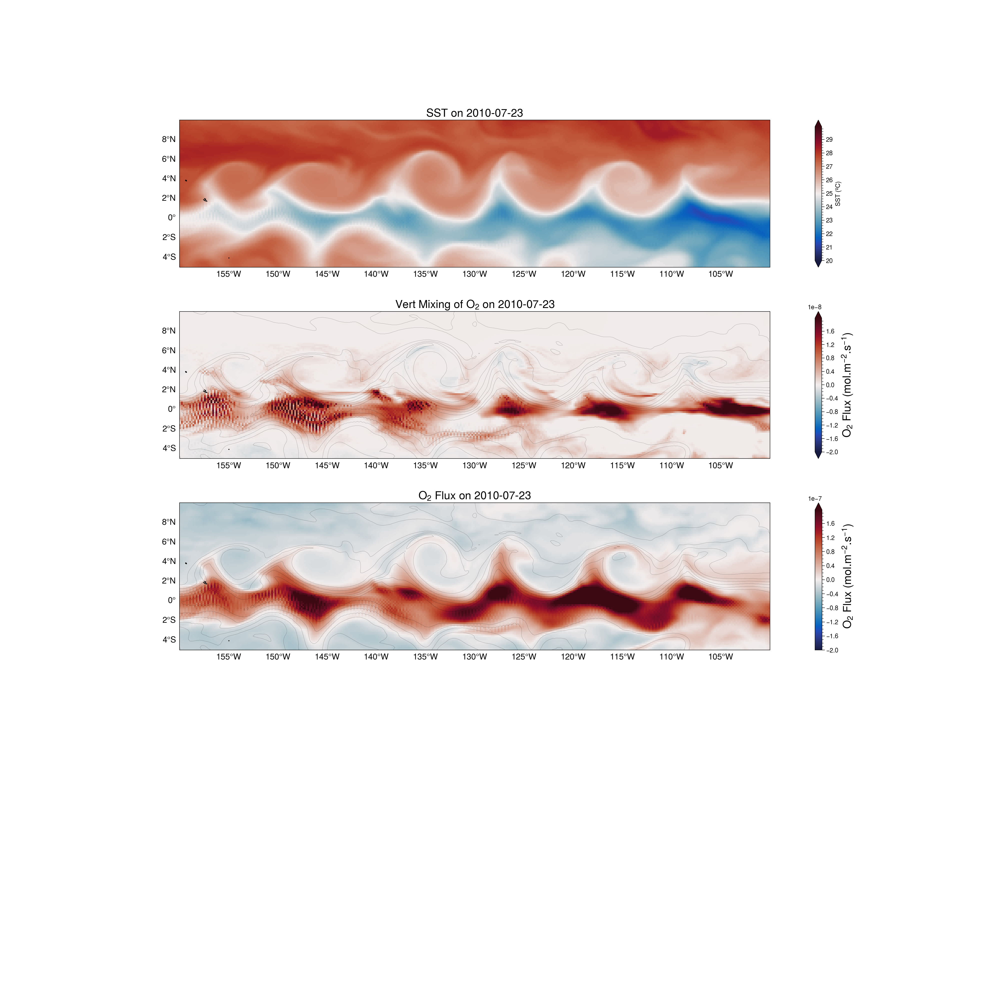

In [22]:
rho =1026
land_50m = cft.NaturalEarthFeature('physical', 'land', '50m',
                                   edgecolor='black', facecolor='gray', linewidth=0.5)
projection=ccrs.Mercator(central_longitude=-200.0, min_latitude=-15.0, max_latitude=15.0) #
fsx=12
fs=16
zz=13
EE=-200.0; WW=-70.1; SS=-17.0; NN=17.1
lon_lab=np.concatenate([np.arange(EE,WW,5)])
lat_lab=np.arange(SS+1,NN-1,2)

Wq=160; Eq=100; Sq=-5; Nq=10

for i in tqdm(np.arange(40,41,2)):
    fig = plt.figure(figsize=(20,20),dpi=100)
    gs = fig.add_gridspec(nrows=3, ncols=1, bottom=0.35,left=0.05, right=0.95, wspace=0.1, hspace=0.3)
    ax = fig.add_subplot(gs[0, 0],projection=projection)
    ax.set_extent([-Wq, -Eq, Sq, Nq], crs=ccrs.PlateCarree())
    ax.add_feature(land_50m)
    ax.coastlines(resolution='50m')
    p1=dsv.THETA.isel(Z=0,time=i).plot(cmap='cmo.balance',add_colorbar=False,levels=np.arange(20,30,0.05), transform=ccrs.PlateCarree())
    cbar = plt.colorbar(p1)
    cbar.set_label('SST (ºC)')
    plt.title("SST on "+ str(dso.time[i])[36:46],fontsize=fs)
    plt.ylabel('latitude (N)',fontsize=fs)
    plt.xlabel('longitude (E)',fontsize=fs)
    gl=ax.gridlines(draw_labels=True)
    gl.xlabel_style = {'size': fsx, 'color': 'black'}; gl.ylabel_style = {'size': fsx, 'color': 'black'}; 
    gl.xlabels_top = False; gl.ylabels_right= False; gl.xlines = False; gl.ylines = False
    gl.xlocator = mticker.FixedLocator(lon_lab); gl.ylocator = mticker.FixedLocator(lat_lab)
    gl.xformatter = LONGITUDE_FORMATTER ; gl.yformatter = LATITUDE_FORMATTER

#     ax = fig.add_subplot(gs[1, 0],projection=projection)
#     ax.set_extent([-Wq, -Eq, Sq, Nq], crs=ccrs.PlateCarree())
#     ax.add_feature(land_50m)
#     ax.coastlines(resolution='50m')
#     # p1=(dso.TRAC03.sel(PD=rho).isel(time=i)*1e3).plot(cmap='acton',add_colorbar=False,levels=np.arange(0,220,5), transform=ccrs.PlateCarree())
#     # dsv.THETA.isel(Z=0,time=i).plot.contour(x='XC', y='YC',levels=np.arange(24,28,0.5), colors='black', linewidths=0.1, transform=ccrs.PlateCarree())
#     # (dso.TRAC03.sel(PD=rho).isel(time=i)*1e3).plot.contour(x='XC', y='YC',vmin=60, vmax=60.1, colors='cyan', linewidths=0.6, transform=ccrs.PlateCarree())
#     p1=(dsv.TRAC03.isel(Z=zz).isel(time=i)*1e3).plot(cmap='acton',add_colorbar=False,levels=np.arange(0,220,5), transform=ccrs.PlateCarree())
#     # (dsv.TRAC03.isel(Z=zz).isel(time=i)*1e3).plot.contour(x='XC', y='YC',vmin=60, vmax=60.1, colors='lime', linewidths=0.5, transform=ccrs.PlateCarree())
#     cbar = plt.colorbar(p1)
#     cbar.set_label('O$_2$ (mmol.m$^{-3}$)',fontsize=fs);
#     plt.title("O$_2$ on $\sigma$="+str((rho-1e3))[:4]+" on "+ str(dso.time[i])[36:46],fontsize=fs)
#     plt.title("O$_2$ on Z="+str((dsv.Z[zz].values))[1:4]+"m on "+ str(dso.time[i])[36:46],fontsize=fs)
#     plt.ylabel('latitude (N)')
#     plt.xlabel('longitude (E)')
#     gl=ax.gridlines(draw_labels=True)
#     gl.xlabel_style = {'size': fsx, 'color': 'black'}; gl.ylabel_style = {'size': fsx, 'color': 'black'}; 
#     gl.xlabels_top = False; gl.ylabels_right= False; gl.xlines = False; gl.ylines = False
#     gl.xlocator = mticker.FixedLocator(lon_lab); gl.ylocator = mticker.FixedLocator(lat_lab)
#     gl.xformatter = LONGITUDE_FORMATTER ; gl.yformatter = LATITUDE_FORMATTER

    ax = fig.add_subplot(gs[1, 0],projection=projection)
    ax.set_extent([-Wq, -Eq, Sq, Nq], crs=ccrs.PlateCarree())
    ax.add_feature(land_50m)
    ax.coastlines(resolution='50m')
    # p1=(dso.TRAC03.sel(PD=rho).isel(time=i)*1e3).plot(cmap='acton',add_colorbar=False,levels=np.arange(0,220,5), transform=ccrs.PlateCarree())
    # dsv.THETA.isel(Z=0,time=i).plot.contour(x='XC', y='YC',levels=np.arange(24,28,0.5), colors='black', linewidths=0.1, transform=ccrs.PlateCarree())
    # (dso.TRAC03.sel(PD=rho).isel(time=i)*1e3).plot.contour(x='XC', y='YC',vmin=60, vmax=60.1, colors='cyan', linewidths=0.6, transform=ccrs.PlateCarree())
    p1=(-dsb.dif_v_O2.sel(Z=slice(-50,-150)).mean('Z').isel(time=i)).plot(cmap='cmo.balance',add_colorbar=False,levels=np.arange(-2e-8,2e-8,0.01e-8), transform=ccrs.PlateCarree())
    dsv.THETA.isel(Z=0,time=i).plot.contour(x='XC', y='YC',levels=np.arange(24,28,0.5), colors='black', linewidths=0.1, transform=ccrs.PlateCarree())

    cbar = plt.colorbar(p1)
    cbar.set_label('O$_2$ Flux (mol.m$^{-2}$.s$^{-1}$)',fontsize=fs);
    plt.title("Vert Mixing of O$_2$ on "+ str(dso.time[i])[36:46],fontsize=fs)
    plt.ylabel('latitude (N)')
    plt.xlabel('longitude (E)')
    gl=ax.gridlines(draw_labels=True)
    gl.xlabel_style = {'size': fsx, 'color': 'black'}; gl.ylabel_style = {'size': fsx, 'color': 'black'}; 
    gl.xlabels_top = False; gl.ylabels_right= False; gl.xlines = False; gl.ylines = False
    gl.xlocator = mticker.FixedLocator(lon_lab); gl.ylocator = mticker.FixedLocator(lat_lab)
    gl.xformatter = LONGITUDE_FORMATTER ; gl.yformatter = LATITUDE_FORMATTER

    ax = fig.add_subplot(gs[2, 0],projection=projection)
    ax.set_extent([-Wq, -Eq, Sq, Nq], crs=ccrs.PlateCarree())
    ax.add_feature(land_50m)
    ax.coastlines(resolution='50m')
    p1=(dsb.surf_O2.isel(Z=0).isel(time=i)).plot(cmap='cmo.balance',add_colorbar=False,levels=np.arange(-2e-7,2e-7,0.01e-7), transform=ccrs.PlateCarree())
    dsv.THETA.isel(Z=0,time=i).plot.contour(x='XC', y='YC',levels=np.arange(24,28,0.5), colors='black', linewidths=0.1, transform=ccrs.PlateCarree())
    cbar = plt.colorbar(p1)
    cbar.set_label('O$_2$ Flux (mol.m$^{-2}$.s$^{-1}$)',fontsize=fs);
    plt.title("O$_2$ Flux on "+ str(dso.time[i])[36:46],fontsize=fs)
    plt.ylabel('latitude (N)')
    plt.xlabel('longitude (E)')
    gl=ax.gridlines(draw_labels=True)
    gl.xlabel_style = {'size': fsx, 'color': 'black'}; gl.ylabel_style = {'size': fsx, 'color': 'black'}; 
    gl.xlabels_top = False; gl.ylabels_right= False; gl.xlines = False; gl.ylines = False
    gl.xlocator = mticker.FixedLocator(lon_lab); gl.ylocator = mticker.FixedLocator(lat_lab)
    gl.xformatter = LONGITUDE_FORMATTER ; gl.yformatter = LATITUDE_FORMATTER
    

Text(0.5, 0, 'Time')

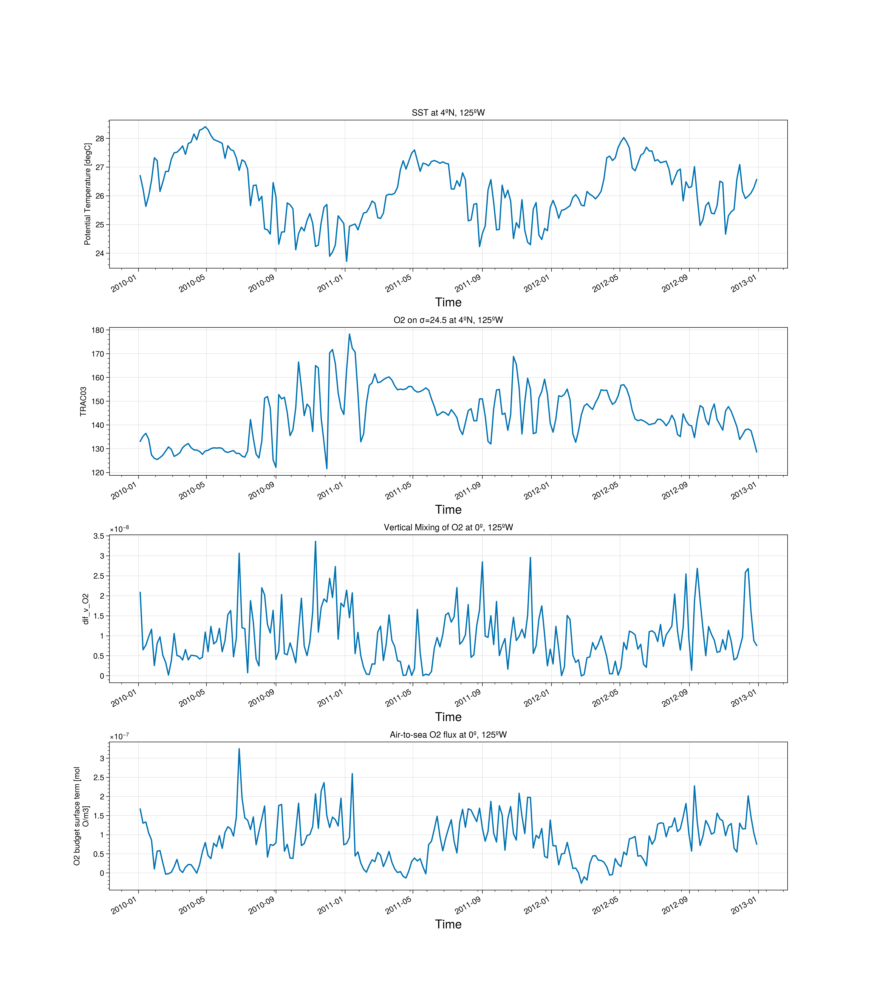

In [256]:
fig = plt.figure(figsize=(14,16),dpi=200, facecolor='white')
gs2 = fig.add_gridspec(nrows=4, ncols=1, hspace=0.4)    #, top=0.3, left=0.38, right=0.95, wspace=0.4, hspace=0.2)    
LON_W=360-125
fs=14

ax = fig.add_subplot(gs2[0,0])
dsl.THETA.isel(Z=0).sel(XC=LON_W,YC=4,method='nearest').plot()
plt.title('SST at 4ºN, 125ºW')
plt.xlabel('Time',fontsize=fs)

ax = fig.add_subplot(gs2[1,0])
(dsol.TRAC03*1e3).sel(XC=LON_W,YC=4,method='nearest').sel(PD=1024.5).plot()
plt.title('O2 on $\sigma$=24.5 at 4ºN, 125ºW')
plt.xlabel('Time',fontsize=fs)

ax = fig.add_subplot(gs2[2,0])
(-dsbl.dif_v_O2).sel(XC=LON_W,YC=0,method='nearest').sel(Z=slice(-50,-150)).mean('Z').plot()
plt.title('Vertical Mixing of O2 at 0º, 125ºW')
plt.xlabel('Time',fontsize=fs)


ax = fig.add_subplot(gs2[3,0])
(dsbl.surf_O2).sel(XC=LON_W,YC=0,method='nearest').isel(Z=0).plot()
plt.title('Air-to-sea O2 flux at 0º, 125ºW')
plt.xlabel('Time',fontsize=fs)


Text(0.5, 0, 'Time')

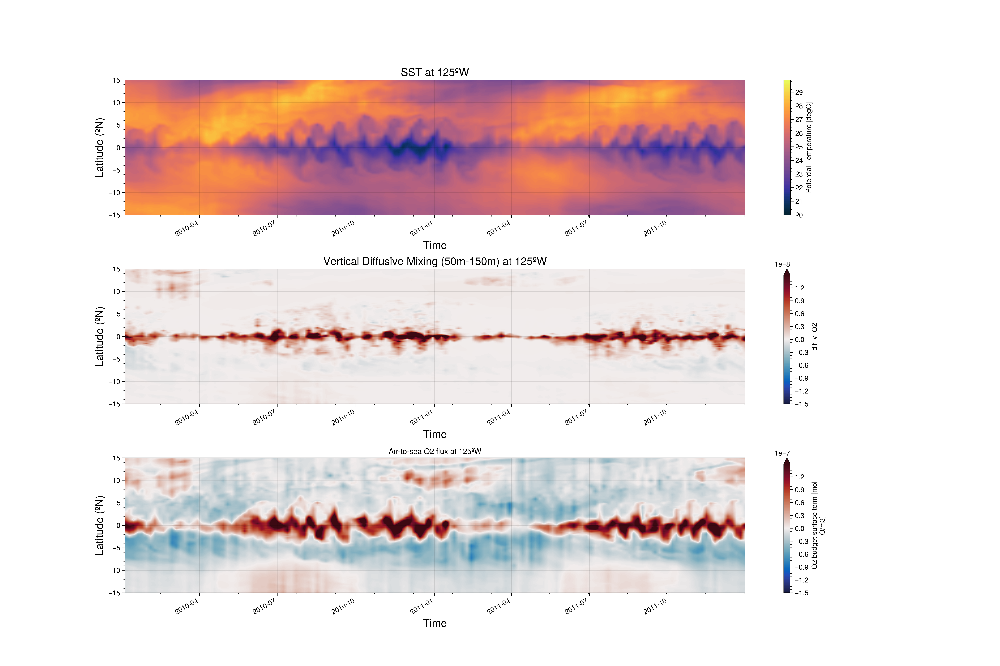

In [236]:
fig = plt.figure(figsize=(18,12),dpi=200, facecolor='white')
fs=14
gs2 = fig.add_gridspec(nrows=3, ncols=1, hspace=0.4)    #, top=0.3, left=0.38, right=0.95, wspace=0.4, hspace=0.2)    

LON_W=360-125
ax = fig.add_subplot(gs2[0,0])
dsl.THETA.isel(Z=0).sel(XC=LON_W,method='nearest').plot.contourf(x='time',levels=np.arange(20,30,0.1),cmap='thermal')
plt.ylim(-15,15)
plt.title('SST at 125ºW',fontsize=fs)
plt.ylabel('Latitude (ºN)',fontsize=fs)
plt.xlabel('Time',fontsize=fs)

ax = fig.add_subplot(gs2[1,0])
(-dsbl.dif_v_O2).sel(XC=LON_W,method='nearest').sel(Z=slice(-50,-150)).mean('Z').plot.contourf(x='time',levels=np.arange(-0.15e-7,0.15e-7,0.01e-8),cmap='cmo.balance')
plt.ylim(-15,15)
plt.title('Vertical Diffusive Mixing (50m-150m) at 125ºW',fontsize=fs)
plt.ylabel('Latitude (ºN)',fontsize=fs)
plt.xlabel('Time',fontsize=fs)

ax = fig.add_subplot(gs2[2,0])
(dsbl.surf_O2).sel(XC=LON_W,method='nearest').isel(Z=0).plot.contourf(x='time',levels=np.arange(-0.15e-6,0.15e-6,0.01e-7),cmap='cmo.balance')
plt.ylim(-15,15)
plt.title('Air-to-sea O2 flux at 125ºW')
plt.ylabel('Latitude (ºN)',fontsize=fs)
plt.xlabel('Time',fontsize=fs)


In [50]:
O2_rho.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/intergals/O2_24_26.nc')
O2d.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/intergals/O2_50_150m.nc')
dsbd.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/intergals/budget_50_150m.nc')

In [ ]:
O2_m=((dsv.TRAC03*dsw.rVOL).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sel(Z=slice(Du,Dl)).sum({'XC','YC','Z'}))
O2_max=O2_m.groupby('time.month').max(dim='time').compute()
O2_min=O2_m.groupby('time.month').min(dim='time').compute()
O2_mn=O2_m.groupby('time.month').mean(dim='time').compute()

In [24]:
O2_rho=((dsv.TRAC03*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC','Z'})).compute()

dsb_rho=(dsb*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC','Z'}).compute()

In [128]:
tend_O2_rho=(dsb.tend_O2*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC','Z'}).compute()

divh_O2_rho=(dsb.adv_h_O2*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC','Z'}).compute()

divv_O2_rho=(dsb.adv_v_O2*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC','Z'}).compute()

dif_O2_rho=(dsb.dif_v_O2*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC','Z'}).compute()

bio_O2_rho=(dsb.bio_O2*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).sum({'XC','YC','Z'}).compute()

surf_O2_rho=(dsb.surf_O2*dsw.rVOL).sel(XC=slice(360-W,360-E)).sel(YC=slice(S,N)).isel(Z=0).sum({'XC','YC'}).compute()

In [ ]:
O2_rho_mn=O2_rho.groupby('time.month').mean(dim='time').compute()

In [47]:
fig = plt.figure(figsize=(17,10),dpi=100, facecolor='white')
fs=14
gs2 = fig.add_gridspec(nrows=3, ncols=1)#, top=0.3, left=0.38, right=0.95, wspace=0.4, hspace=0.2)    

ax = fig.add_subplot(gs2[0,0])
pc=ax.plot(dsv.time,O2_rho,color='black', Linewidth=2,label='O$_2$')
# ax.set_xlim([0., 13.])

ax.minorticks_on()
ax.set_xlabel('Time ',fontsize=fs)
ax.xaxis.set_ticks_position('bottom')
ax.set_ylabel(r'O$_2$ (mmol.m$^{-3})$)',fontsize=fs)
ax.set_title(r'O$_2$ and EKE',fontsize=fs,loc='right')
ax.tick_params(axis='both', which='major', labelsize=fs)
plt.legend(loc='best',fontsize=fs,frameon=False)

ax2 = ax.twinx()
color = 'royalblue'
ax2.set_ylabel('EKE(cm$^2$/s$^2$)', color=color,fontsize=fs)  
ax2.plot(dsv.time[9:-9],EKE_m[9:-9]*1e4,color=color,Linewidth=2,label='EKE') 
ax2.tick_params(axis='y', labelcolor=color)
ax2.tick_params(axis='both', which='major', labelsize=fs)
ax2.grid(False)
# plt.xlim(1,12)
plt.legend(fontsize=fs,frameon=False)

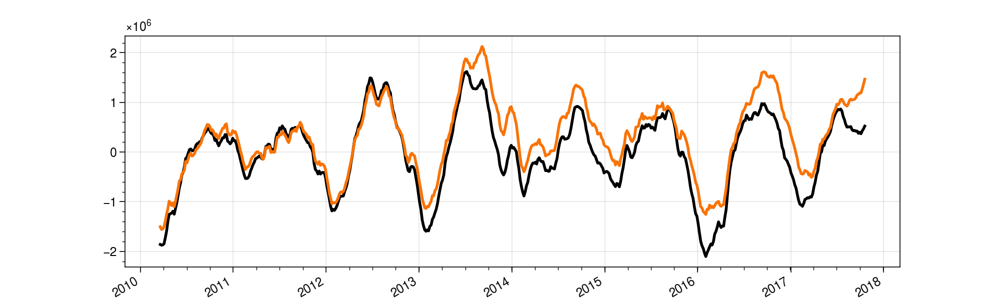

In [122]:
dsbd.tend_O2.rolling(time=5*6,center=True).mean().plot(figsize=(10,3),label='sum', lw=2,color='k')
tend_O2_rho.rolling(time=5*6,center=True).mean().plot(label='sum', lw=2,color='orange')

100%|██████████| 2/2 [01:50<00:00, 55.44s/it]


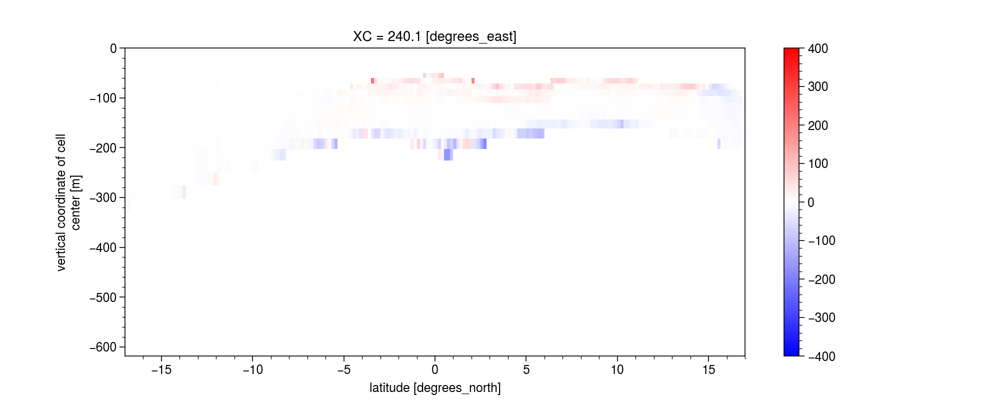

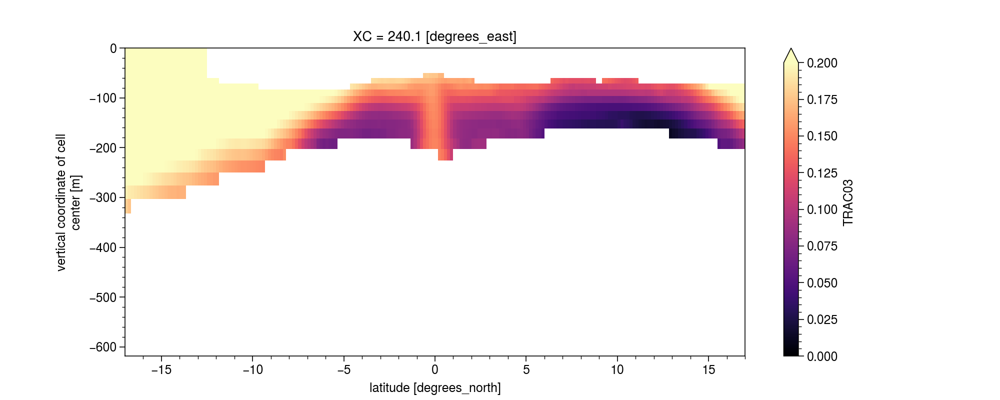

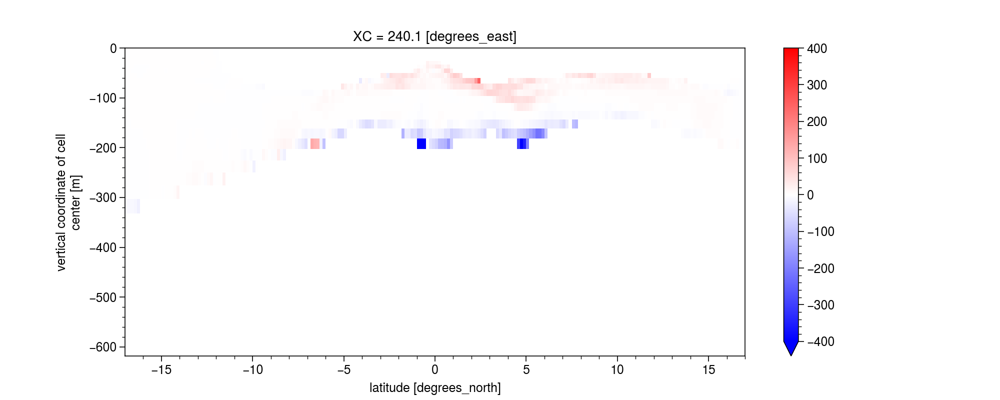

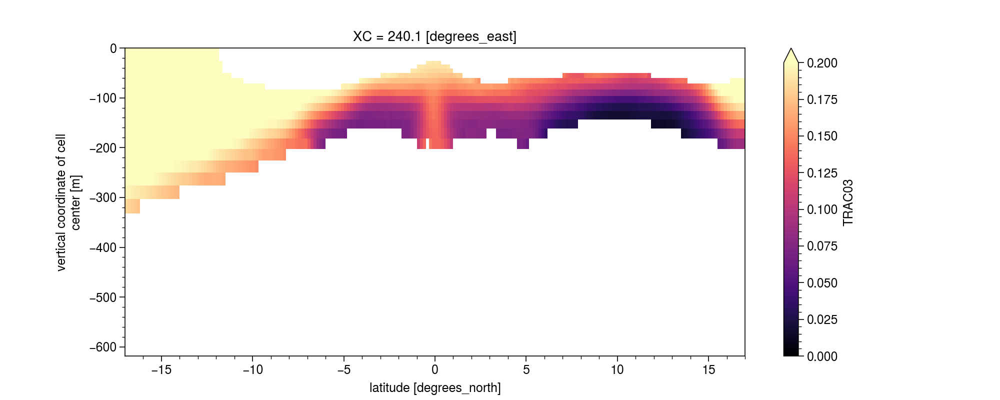

In [130]:
for j in tqdm([2015,2014]):
    (dsb.tend_O2*dsw.rVOL).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(time=str(j)).mean('time').sel(XC=360-120,method='nearest').plot( vmin=-400,vmax=400,figsize=(10,4),cmap='bwr')
    (dsv.TRAC03).where((dsv.PD>rho_u)&(dsv.PD<rho_d)).sel(time=str(j)).mean('time').sel(XC=360-120,method='nearest').plot( vmin=0,vmax=0.20,figsize=(10,4),cmap='magma')

### Calculate Eddy Kinetic Energy using residual from from 90 days running mean:

In [93]:
def EKE(U,V,Um,Vm):
    U_p=(U-Um)
    V_p=(V-Vm)
    eke=((U_p**2+V_p**2)/2)    
    return eke

def to_cell_center(ds):
    ds = ds.copy()
    for dim in ds.dims:
        if dim in ["XG"]:
            ds = ds.drop(dim).rename({dim: "XC"})
    for dim in ds.dims:
        if dim in ["YG"]:
            ds = ds.drop(dim).rename({dim: "YC"})            
    return ds

# Calculate EKE
dsu=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/variables_201?.nc').isel(Z=0)#.isel(time=np.arange(0,293))
dsu=to_cell_center(dsu)
ndays=90; ndt=int(ndays/5)
Urm=dsu.UVEL.rolling(time=ndt,center=True).mean().compute()
Vrm=dsu.VVEL.rolling(time=ndt,center=True).mean().compute()
eke=EKE(dsu.UVEL,dsu.VVEL,Urm,Vrm)
eke.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/EKE_2010_2017.nc')

In [484]:
for j in tqdm(np.arange(0,8)):
    N=73
    dsv=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_?VEL_5day_201'+str(j)+'.nc').isel(time=np.arange(0,N))
    dst=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_T*_5day_201'+str(j)+'.nc').isel(time=np.arange(0,N))
    dsp=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_PD_5day_201'+str(j)+'.nc').isel(time=np.arange(0,N))
    dsb=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_*_O2_5day_201'+str(j)+'.nc').isel(time=np.arange(0,N))
    dsb['time']=dst.time
    dsb2=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_adv_[hv][uw]O2_5day_201'+str(j)+'.nc').isel(time=np.arange(0,N))
    dsb2['time']=dst.time
    dsb=xr.merge([dsb,dsb2],compat='override')
    dsb['rVOL']=dst.drF*dst.rA*dst.hFacC
    dst=xr.merge([dst,dsv,dsp],compat='override')
    dst['rVOL']=dst.drF*dst.rA*dst.hFacC
    dsb.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/budgets_201'+str(j)+'.nc')
    dst.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/variables_201'+str(j)+'.nc')

100%|██████████| 8/8 [08:59<00:00, 67.42s/it]


In [48]:
import gsw

# 5-day mean temp, O2 and salt from Forward MITgcm run with BGC
for j in tqdm(np.arange(5,8)):
    dst=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_THETA_5day_201'+str(j)+'.nc')
    dss=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_SALT_5day_201'+str(j)+'.nc')
    dsp=xr.Dataset()
    dsp['PD']=gsw.density.sigma0(dss.SALT,dst.THETA)+1000
    dsp.PD.attrs['long_name']='Potential density'
    dsp.PD.attrs['units']='kg m-3'
    dsp.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/tpfwd6_PD_5day_201'+str(j)+'.nc')

100%|██████████| 3/3 [01:11<00:00, 23.78s/it]


In [16]:
rho = np.arange(1022.5,1027.5, 0.25)

for j in tqdm(np.arange(6,8)):
    dsp=xr.open_mfdataset('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/variables_201'+str(j)+'.nc',chunks={"time":5,"XC":300,"YC":50})
    grid = Grid(dsp, coords={'Z': {'center':'Z'}}, periodic=False)
    ds_rho=xr.Dataset()
    ds_rho['TRAC03'] = grid.transform(dsp.TRAC03,'Z',rho,target_data=dsp.PD)
    ds_rho.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/budgets/rho_O2_5day_201'+str(j)+'.nc')

100%|██████████| 2/2 [09:47<00:00, 293.83s/it]


In [17]:
from xgcm import Grid
rho = np.arange(1022.5,1027.5, 0.25)
grid = Grid(dst, coords={'Z': {'center':'Z'}}, periodic=False)
ds_rho=xr.Dataset()
ds_rho['O2'] = grid.transform(dst.TRAC03,'Z',rho,target_data=dsp.PD)
ds_rho['tend_O2'] = grid.transform(dsb.tend_O2,'Z',rho,target_data=dsp.PD)
ds_rho['adv_h_O2'] = grid.transform(dsb.adv_h_O2,'Z',rho,target_data=dsp.PD)
ds_rho['adv_v_O2'] = grid.transform(dsb.adv_v_O2,'Z',rho,target_data=dsp.PD)
ds_rho['dif_v_O2'] = grid.transform(dsb.dif_v_O2,'Z',rho,target_data=dsp.PD)
ds_rho['j_O2'] = grid.transform(dsb.bio_O2,'Z',rho,target_data=dsp.PD)

ds_rho.to_netcdf('/glade/scratch/yeddebba/Mesoscale/TPOSE/MITgcm_BLING_BUDGET_2010_2013_5DAY/RHO_O2_5day_2010s.nc')

AttributeError: 'NoneType' object has no attribute 'lock_acquire'

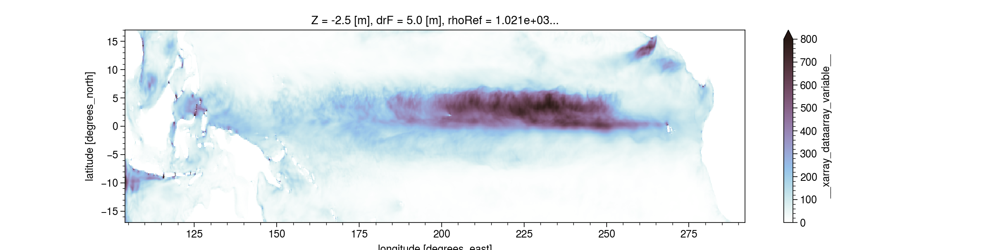

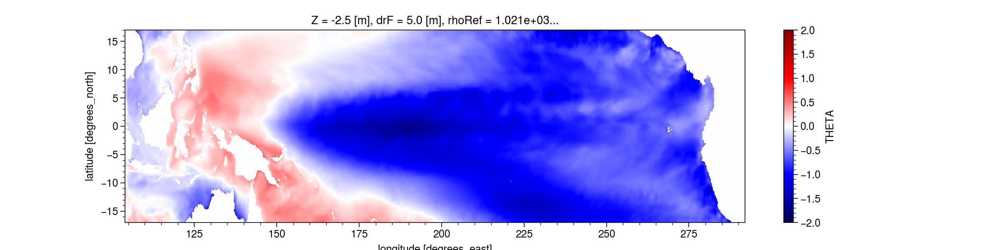

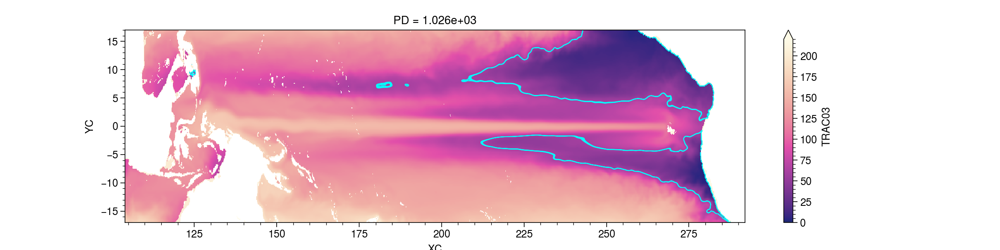

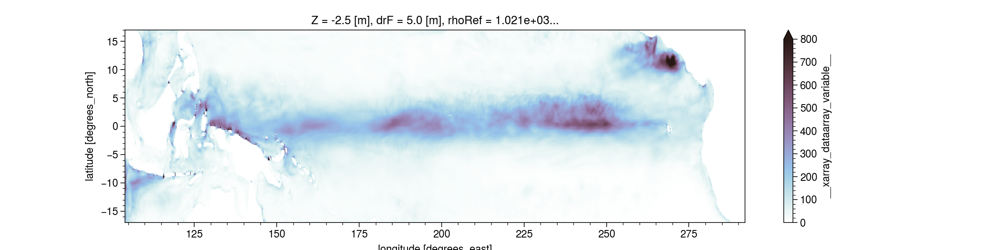

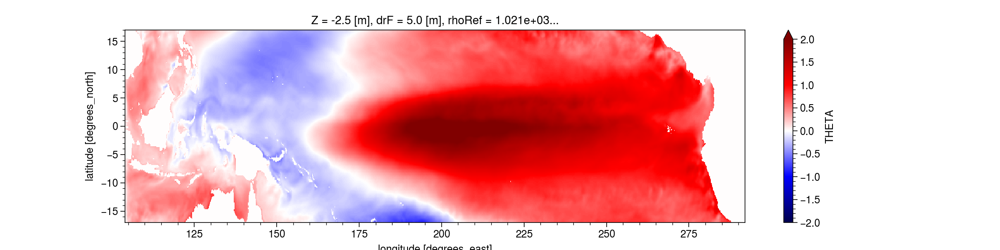

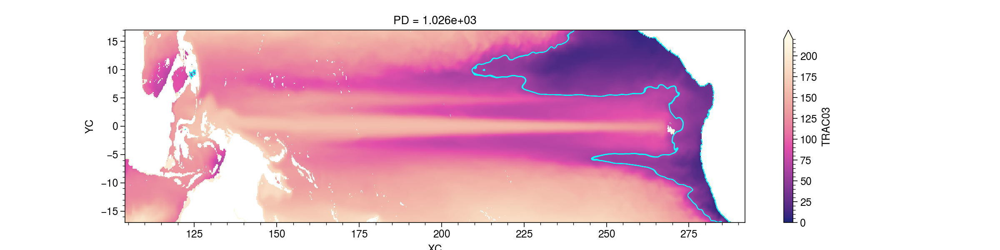

In [138]:
    
t1='2010-07'
t2='2011-07'
(EKE.sel(time=slice(t1,t2)).mean('time')*1e4).plot(figsize=(12,3),cmap='Glacial',vmax=8e2)
(anomaly(dsv.THETA.isel(Z=0)).sel(time=slice(t1,t2)).mean('time')).plot(figsize=(12,3),cmap='seismic',vmin=-2,vmax=2)
(ds_rho.TRAC03.sel(PD=1026).sel(time=slice(t1,t2)).mean('time')*1e3).plot(figsize=(12,3),cmap='sunset_r',vmin=0,vmax=2.2e2)
(ds_rho.TRAC03.sel(PD=1026).sel(time=slice(t1,t2)).mean('time')*1e3).plot.contour(x='XC', y='YC',vmin=60, vmax=61, colors='cyan', linewidths=0.6)

t1='2015-07'
t2='2016-07'

(EKE.sel(time=slice(t1,t2)).mean('time')*1e4).plot(figsize=(12,3),cmap='Glacial',vmax=8e2)
(anomaly(dsv.THETA.isel(Z=0)).sel(time=slice(t1,t2)).mean('time')).plot(figsize=(12,3),cmap='seismic',vmin=-2,vmax=2)
(ds_rho.TRAC03.sel(PD=1026).sel(time=slice(t1,t2)).mean('time')*1e3).plot(figsize=(12,3),cmap='sunset_r',vmin=0,vmax=2.2e2)
(ds_rho.TRAC03.sel(PD=1026).sel(time=slice(t1,t2)).mean('time')*1e3).plot.contour(x='XC', y='YC',vmin=60, vmax=61, colors='cyan', linewidths=0.6)

rho=1026.0
for j in tqdm([1,3,6,9]):
    t1='2011-0'+str(j)
    (ds_rho.TRAC03.sel(PD=rho).sel(time=t1).mean('time')*1e3).plot(figsize=(12,3),cmap='sunset_r',vmin=0,vmax=2.5e2)
    (ds_rho.TRAC03.sel(PD=rho).sel(time=t1).mean('time')*1e3).plot.contour(x='XC', y='YC',vmin=60, vmax=61, colors='cyan', linewidths=0.6)
    plt.title(str(t1))
    